In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as dates
import seaborn as sns
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset,DataLoader

import tqdm, time, os, datetime, glob, warnings, random
from sklearn.preprocessing import LabelEncoder
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
warnings.filterwarnings('ignore')

#데이터 불러오기


In [ ]:
root = '/content/drive/MyDrive/open'
train_df = original_df = pd.read_csv(f'{root}/train.csv')
sales_df = pd.read_csv(f'{root}/sales.csv')
brand_keyword_df = pd.read_csv(f'{root}/brand_keyword_cnt.csv')
product_info_df = pd.read_csv(f'{root}/product_info.csv')



15890개의 상품과 449개의 시간별 판매량,판매금액

In [ ]:
print(train_df.shape)
print(sales_df.shape)
print(brand_keyword_df.shape)
print(product_info_df.shape)

(15890, 465)
(15890, 465)
(3170, 460)
(12778, 2)


In [ ]:
train_df.head()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,1,3,2,0,0,2,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
train_df = pd.melt(train_df, id_vars=['ID','제품','대분류','중분류','소분류','브랜드'])
train_df.rename(columns={'variable':'일자','value':'판매량'},inplace=True)

In [ ]:
train_df.describe() #숫자형 describe

,ID,판매량
count,7.293510e+06,7.293510e+06
mean,7.944500e+03,1.765760e+01
std,4.587048e+03,2.827275e+02
min,0.000000e+00,0.000000e+00
25%,3.972000e+03,0.000000e+00
50%,7.944500e+03,0.000000e+00
75%,1.191700e+04,3.000000e+00
max,1.588900e+04,2.004200e+05


In [ ]:
train_df.describe(include=['O']) #범주형 describe


,제품,대분류,중분류,소분류,브랜드,일자
count,7293510,7293510,7293510,7293510,7293510,7293510
unique,15840,5,11,53,3170,459
top,B002-00070-00009,B002-C001-0002,B002-C002-0001,B002-C003-0003,B002-00894,2022-01-01
freq,918,5027886,1656072,654534,70227,15890


In [ ]:
sales_df.head()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,22400,67200,44800,0,0,44800,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
sales_df = pd.melt(sales_df, id_vars=['ID','제품','대분류','중분류','소분류','브랜드'])
sales_df.rename(columns={'variable':'일자','value':'판매금액'},inplace=True)

In [ ]:
sales_df.describe()

,ID,판매금액
count,7.293510e+06,7.293510e+06
mean,7.944500e+03,1.170611e+05
std,4.587048e+03,8.571531e+05
min,0.000000e+00,0.000000e+00
25%,3.972000e+03,0.000000e+00
50%,7.944500e+03,0.000000e+00
75%,1.191700e+04,3.180000e+04
max,1.588900e+04,2.166940e+08


In [ ]:
sales_df.describe(include=['O'])

,제품,대분류,중분류,소분류,브랜드,일자
count,7293510,7293510,7293510,7293510,7293510,7293510
unique,15840,5,11,53,3170,459
top,B002-00070-00009,B002-C001-0002,B002-C002-0001,B002-C003-0003,B002-00894,2022-01-01
freq,918,5027886,1656072,654534,70227,15890


In [ ]:
#수정한 train_df와 sales_df 는 ['ID','제품','대분류','중분류','소분류','브랜드','일자']가 동일하므로 병합
train_df = pd.merge(train_df, sales_df, on=['ID','제품','대분류','중분류','소분류','브랜드','일자'], how='left')

In [ ]:
brand_keyword_df.head()

,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,2022-01-05,2022-01-06,2022-01-07,2022-01-08,2022-01-09,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,B002-00001,0.84131,0.91383,1.450530,2.422390,1.871190,1.581080,1.232950,1.174930,1.145920,...,0.319110,0.391640,0.377130,0.49318,0.072520,0.29010,0.31911,0.232080,0.333620,0.44966
1,B002-00002,12.64868,20.27850,15.332170,12.750210,13.562510,13.707570,11.937910,15.564250,14.084710,...,10.269790,11.966920,10.646930,10.41485,10.487380,9.48651,9.28343,10.429350,11.154620,11.38671
2,B002-00003,0.33362,0.43516,0.362630,0.174060,0.217580,0.464170,0.420650,0.290100,0.377130,...,0.536690,0.696250,0.449660,0.39164,1.029880,0.49318,0.91383,0.797790,1.015370,0.88482
3,B002-00005,1.07339,1.71163,2.016240,1.914700,1.987230,2.146790,1.682620,1.378000,1.421520,...,2.219320,2.509420,2.872060,2.37888,2.030750,1.53756,1.34899,1.261960,2.320850,2.30635
4,B002-00006,0.00000,0.00000,0.188558,0.246574,0.246574,0.246574,0.377139,0.087012,0.261084,...,0.072526,0.290103,0.087012,0.00000,0.130542,0.00000,0.00000,0.072526,0.217577,0.00000


In [ ]:
brand_keyword_df = pd.melt(brand_keyword_df, id_vars=['브랜드'])
brand_keyword_df.rename(columns={'variable':'일자','value':'언급량'},inplace=True)

In [ ]:
brand_keyword_df.describe()

,언급량
count,1.438965e+06
mean,4.835876e+00
std,3.328714e+01
min,0.000000e+00
25%,8.703000e-02
50%,4.786700e-01
75%,2.190310e+00
max,1.338332e+04


In [ ]:
brand_keyword_df.describe(include=['O'])

,브랜드,일자
count,1455030,1455030
unique,3170,459
top,B002-00001,2022-01-01
freq,459,3170


In [ ]:
#수정한 train_df와 brand_keyword_df 는 ['브랜드','일자']가 동일하므로 병합
train_df = pd.merge(train_df, brand_keyword_df, on=['브랜드','일자'], how='left')

In [ ]:
product_info_df.shape

(12778, 2)

In [ ]:
product_info_df.head()

,제품,제품특성
0,B002-03509-00001,제품유형:일반식품 콜라겐 펩타이드:1000mg 종류:어류 분자량:300Da 섭취대상...
1,B002-02376-00001,700mg x 28정
2,B002-03735-00001,제품타입:정 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 두 번 1일 총 섭...
3,B002-03735-00003,제품타입:정 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 한 번 1일 총 섭...
4,B002-02769-00001,HCA:900mg 영양소 원료명(식약처고시):비타민B1 영양소 원료명(식약처고시):...


In [ ]:
product_info_df.describe()

,제품,제품특성
count,12778,12778
unique,12778,12195
top,B002-03509-00001,칫솔종류칫솔모타입:일반 칫솔
freq,1,27


In [ ]:
original_df

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,1,3,2,0,0,2,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15885,15885,B002-03799-00002,B002-C001-0003,B002-C002-0008,B002-C003-0042,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15886,15886,B002-03799-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,3,0,2,4,1,1,3
15887,15887,B002-03799-00004,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15888,15888,B002-03799-00005,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2


In [ ]:
original_df_with_product_info = pd.merge(original_df.drop(original_df.columns[6:],axis=1), product_info_df, on=['제품'], how='left')#.dropna()

original_df_with_product_info.head()

original_df_with_product_info['제품특성번호'] = original_df_with_product_info['제품특성'].astype('category').cat.codes

In [ ]:
train_df_with_product_info = pd.merge(train_df, product_info_df, on=['제품'], how='left')#.dropna()

train_df_with_product_info.head()

train_df_with_product_info['제품특성번호'] = train_df_with_product_info['제품특성'].astype('category').cat.codes

In [ ]:
train_df['일자'] = pd.to_datetime(train_df['일자'], format='%Y-%m-%d')


In [ ]:
train_df['평균판매금액'] = train_df['판매금액']/train_df['판매량']

In [ ]:
print('train_df NULL 값')
print(train_df.isnull().sum())

print('train_df NaN 값')
print(train_df.isna().sum())

In [ ]:
train_df = train_df.fillna(0)

In [ ]:
print('train_df NULL 값')
print(train_df.isnull().sum())

print('train_df NaN 값')
print(train_df.isna().sum())

In [ ]:
#최종 확인
train_df.head()

In [ ]:
train_df.describe()

In [ ]:
train_df.dtypes

# 데이터 불러오기 요약

대회 정보

- 2023-04-05 ~ 2023-04-25 에 대한 판매량 예측

파일 설명

- train_df = train.scv + sales.scv + brand_keyword_cnt.csv
- product_info.csv를 어떻게 활용하면 좋을까?



train_df
- ID : 제품별 개별 ID  
    **단, 제품이 동일하여도 판매되고 있는 고유 ID 별로 기재한 분류 정보가 상이할 수 있음
즉 고유 ID가 다르다면, 제품이 같더라도 다른 판매 채널**
- 제품 : 제품코드 (동일하다고 하여도 분류에 따라 다름) , int
- 대분류 :  
- 중분류 :
- 소분류 :
- 브랜드 : 브랜드
- 일자 : 판매일 , datetime
- 판매량 : 일별 판매량 총합 , int
- 판매금액 : 일별 판매금액 총합 , int
- 언급량 : 브랜드별 언급량 , float
- [제품특성,제품특성번호] : 제품별 특성으로 original_df_with_product_info 에 있음

추출할만한 정보

8월 1일차

- 일별 평균 판매금액 : 판매금액 / 판매량

- 수요량 : 브랜드 언급이 없다는 것은 수요가 없으므로 판매량이 0이 될 수도 있음

- 공급량 : 브랜드 언급이 많은데도 공급이 없으면 수요량이 0이 될 수 있음

- 명절같은 이벤트 : 일자를 통해 얻어낼 수 있음

(2022년 대체공휴일 정보 https://www.supercoloring.com/ko/holidays/south-korea/2022#gsc.tab=0)

(2023년 대체공휴일 정보 https://www.supercoloring.com/ko/holidays/south-korea/2023#gsc.tab=0)


# 해커톤 추천

최종 강의에서 말했던 해커톤 추천

1. 소비재의 특성을 기준으로 구분

2. 브랜드의 인지도 충성도 등은 컬럼이 있는 것은 아니지만 어떻게 인지도 측정할지 생각해보기

3. 구매 접근성은 온라인만 있기 때문에 상관은 없지만 참고만 할 것

4. 가격 포지셔닝 어떤 제품군이 또는 제품군 내의 제품이 브랜드가 가격적으로 어떤 포지셔닝인가 확인

5. 그 제품의 가격이 변동될 때 가격에 얼마나 민감하게 반응하는지?

6. 본품인지 리필인지 구분

7. 대용량 소용량 구분 -> 판매 비중이 유지될 것이다.

8. 이벤트 명절기간에 선물 세트가 위주로 나가면서 샴푸가 안팔리는 경향

9. 할인 기간 가격 기준으로 해서 피처 확인

10. 광고는 활용하기 어렵지만 참고만 했으면 좋겠다

11. 제품군별 특징 고려 -> 생활용품이 수요가 그렇게 급변하지는 않음, 이 때문에 제품군의 수요가 크게 변하지 않음

12. 판매량 데이터는 수요와 공급이 딱 만나는 그 지점이다 -> 공급이 안되면 판매가 되지 않음, 즉, 공급 수요에 의한 판매량 확인

# 이상치 확인,제거

In [ ]:
train = train_df.copy()
train = train.sort_values(by=['ID','일자'])

tmp = train.copy()
tmp['평균판매금액'] = np.round(tmp['평균판매금액'].values,-2)
tmp['판매금액'] = tmp['판매량']*tmp['평균판매금액']

summation = tmp[tmp['판매량']>0].groupby(['ID','평균판매금액']).mean().reset_index()


## 함수 선언(따로 안펼쳐도 됩니다.)

In [113]:
def clear_outliar(data,lst):
    id,filter_attr,value,updown,target_attr,mean_sales_revise = lst


    if updown == "이상" :
        idx = data[filter_attr]>= value
    elif updown == "이하" :
        idx = (data[filter_attr]<=value )& (data[filter_attr]>0)
    else :
        print(updown,"이 잘못되었습니다.")

    filter = data[data['판매량']>0]
    if len(filter)>0:

        if mean_sales_revise :
            data.loc[idx,'평균판매금액'] = np.median(filter['평균판매금액'].values)


        if target_attr == "판매금액" :
            data.loc[idx,'판매금액'] = data.loc[idx,'판매량']*data.loc[idx,'평균판매금액']

        elif target_attr == "판매량" :
            data.loc[idx,'판매량'] = data.loc[idx,'판매금액']/data.loc[idx,'평균판매금액']

        elif target_attr ==  "량금" :

            data.loc[idx,'판매량'] = np.median(filter['판매량'].values)
            data.loc[idx,'판매금액'] = data.loc[idx,'판매량'] * data.loc[idx,'평균판매금액']

    return data,idx

In [114]:
def print_plt(id,data,col=4):

    corr = np.corrcoef(data['판매량'], data['판매금액'])

    print(f'ID : {id//459} 의 판매량 판매 금액 상관계수 = {corr[0][1]}')


    plt.figure(figsize=(30, 5))
    plt.subplot(1,col,1)
    sns.lineplot(x=data['일자'], y=data['판매량'].values,marker='o')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)



    z_score25 = 0
    z_score30 = 0
    tmp = data[data['판매량']>0]['판매량'].values
    if len(tmp)>0:
        z_score = (tmp-np.mean(tmp))/np.std(tmp)
        z_score25 = tmp[z_score>2.5]
        z_score30 = tmp[z_score>3.0]
        if len(z_score25) == 0:
            z_score25 = tmp.max()+1
        else :
            z_score25 = z_score25.min()
        plt.hlines(z_score25,data['일자'].min(),data['일자'].max(),color='red', linestyle='solid', linewidth=1,label='Z-Score 2.5')


        if len(z_score30) == 0:
            z_score30 = tmp.max()+1
        else :
            z_score30 = z_score30.min()
        plt.hlines(z_score30,data['일자'].min(),data['일자'].max(),color='blue', linestyle='solid', linewidth=1,label='Z-Score 3.0')

    if len(data[data['판매량']>0]['판매량'].values)>0:
        IQR = np.quantile(data[data['판매량']>0]['판매량'].values, 0.875)
    else :
        IQR = 0

    plt.hlines(IQR,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=1,label='IQR 87.5')
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'Sales (Z-Score(R,B), IQR(G)) = ({z_score25}, {z_score30}, {IQR})')

    plt.subplot(1,col,2)
    sns.lineplot(x=data['일자'], y=data['판매금액'].values,marker='o')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)

    tmp = data[data['판매금액']>0]['판매금액'].values
    z_score25 = 0
    z_score30 = 0

    if len(tmp)>0:

        z_score = (tmp-np.mean(tmp))/np.std(tmp)
        z_score25 = tmp[z_score>2.5]
        z_score30 = tmp[z_score>3.0]
        if len(z_score25) == 0:
            z_score25 = tmp.max()+1
        else :
            z_score25 = z_score25.min()
        plt.hlines(z_score25,data['일자'].min(),data['일자'].max(),color='red', linestyle='solid', linewidth=1,label='Z-Score 2.5')

        if len(z_score30) == 0:
            z_score30 = tmp.max()+1
        else :
            z_score30 = z_score30.min()
        plt.hlines(z_score30,data['일자'].min(),data['일자'].max(),color='blue', linestyle='solid', linewidth=1,label='Z-Score 3.0')

    if len(data[data['판매금액']>0]['판매금액'].values)>0:
        IQR = np.quantile(data[data['판매금액']>0]['판매금액'].values, 0.875)

    else :
        IQR = 0
    plt.hlines(IQR,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=1,label='IQR 87.5')
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'Price (Z-Score(R,B), IQR(G)) = ({z_score25}, {z_score30}, {IQR})')

    plt.subplot(1,col,3)
    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,marker='o')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    tmp = data[data['평균판매금액']>0]['평균판매금액']
    if len(tmp)>0:
        plt.hlines(tmp.median(),data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=1,label='Z-Score 3.0')
    plt.title(f'Mean Price(Median(G))')

    plt.subplot(1,col,4)
    sns.lineplot(x=data['일자'], y=data['언급량'].values,marker='o')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'Keyword')

    if col==5:
        tmp = data[data['판매량']>0]
        mean_price=0
        if len(tmp)>0:
            mean_price = np.round(tmp['평균판매금액'].mean(),-2)

        plt.subplot(1,col,col)
        sns.lineplot(x=sum_data['평균판매금액'].values, y=sum_data['판매량'].values,marker='o')
        plt.vlines(mean_price,sum_data['판매량'].min(),sum_data['판매량'].max(),color='green', linestyle='solid', linewidth=1)
        plt.xticks(rotation=90)

        plt.title(f'Sales with Mean Price (round{mean_price})')

    plt.show()



## 아웃라이어 확인,수정

In [ ]:
start =0
end =1000

for i in range(start*459,end*459,459):
    sum_data = summation[summation['ID']==i//459]

    data = train.iloc[i:i+459]

    print_plt(i,data,5)

In [116]:
start =0
end =1000

count = 0
for i in range(start*459,end*459,459):
    sum_data = summation[summation['ID']==i//459]
    data = train.iloc[i:i+459]

    without_zero = data[data['판매량']>0]

    min = without_zero['평균판매금액'].min()
    max = without_zero['평균판매금액'].max()
    median = without_zero['평균판매금액'].median()
    mean = without_zero['평균판매금액'].mean()

    filter = 0.5 # 최대 최소값이 중간가격에 5퍼 이상의 차이가 있으면 이상치라고 판단
    if len(without_zero)>0:
        if (min != max):
            if median*(1+filter) <= max or median*(1-filter) >= min:
                max_idx = sum_data['판매량'].values.argmax() #최다 판매 가격
                print("제품 ", i//459)

                print("최소 제품 가격 :",min)
                print("최대 제품 가격 :",max)
                print("중간 제품 가격 :",median)
                print("평균 제품 가격 :",mean)
                print("최다 판매 제품 가격 :",sum_data['평균판매금액'].values[max_idx])



                print_plt(i,data,5)
                count+=1
print(count)

Output hidden; open in https://colab.research.google.com to view.

수정전
ID : 158 의 판매량 판매 금액 상관계수 = 0.9227003356521905


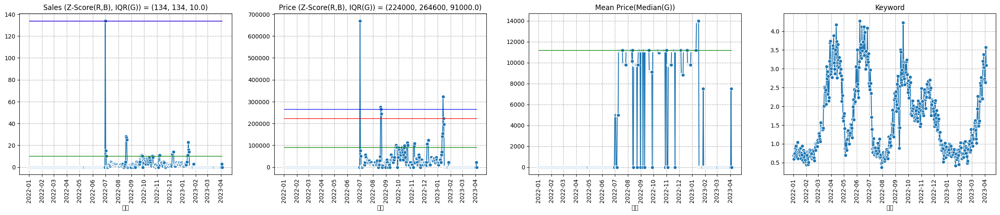

수정후
ID : 158 의 판매량 판매 금액 상관계수 = 0.9962540835241327


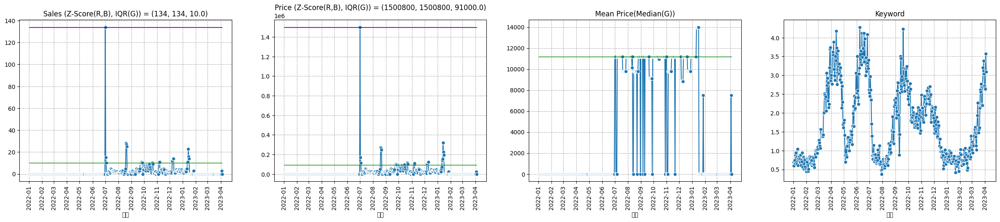

In [119]:
#[(제품아이디),(기준),(필터값),(이상이하),(수정할것),(평균판매금액 수정여부)]

## 수정할 것에는 '량금', '판매량', '판매금액' 중 하나가 들어가면 됩니다.

#lst = [66,'평균판매금액',20000,'이하','판매금액',True]
lst = [158,'평균판매금액',5000,'이하','판매금액',True]

i = lst[0]*459

data = train.iloc[i:i+459].copy()
print("수정전")
print_plt(i,data)

data,idx = clear_outliar(data,lst)
print("수정후")
print_plt(i,data)

#EDA

**추출하면 좋음 속성**

- 일별 평균판매금액 ( 할인율에 대한 정보 )

- 양력,음력 데이터 ( 추석,설 명절에대한 시간 정보 )

- 요일 정보 ( 주말 평일 )

- 공휴일 정보( )

- 한달 내에 몇번째 주차인지에 대한 정보

-

## ○ 일별 전체 판매량,일별판매금액,일별평균판매금액 추이 ( ★ )

**요약**

- 22년 2월 설날과 22년 9월 추석 23년에 1월 설날 판매량 감소

- 판매금액의 경향성은 판매량과 비슷하나 조금 더 안정된 변화량을 가짐

- 10월 개천절 부근 판매량이 급증하나 판매금액은 동일 -> 그러나 평균 판매금액도 변화가 없음 뭐지?

- 23년 2월말 ~ 3월달의 판매량 감소 평균가격 상승이 원인인 듯 함

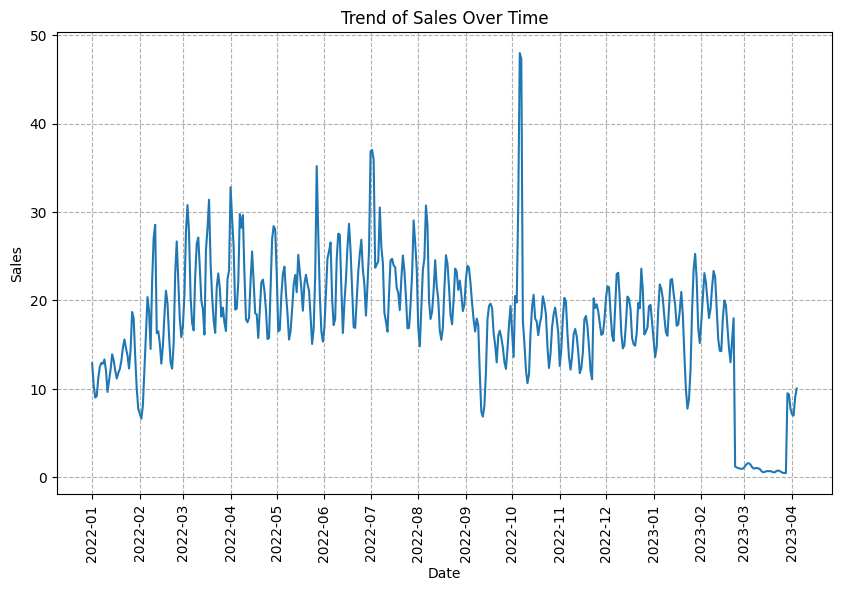

In [ ]:
daily_sales = train_df.resample('D', on='일자').mean()['판매량']
plt.figure(figsize=(10, 6))
sns.lineplot(x=daily_sales.index, y=daily_sales.values)
plt.title('Trend of Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())
plt.show()

In [ ]:
daily_sales[daily_sales<5].index

DatetimeIndex(['2023-02-23', '2023-02-24', '2023-02-25', '2023-02-26',
               '2023-02-27', '2023-02-28', '2023-03-01', '2023-03-02',
               '2023-03-03', '2023-03-04', '2023-03-05', '2023-03-06',
               '2023-03-07', '2023-03-08', '2023-03-09', '2023-03-10',
               '2023-03-11', '2023-03-12', '2023-03-13', '2023-03-14',
               '2023-03-15', '2023-03-16', '2023-03-17', '2023-03-18',
               '2023-03-19', '2023-03-20', '2023-03-21', '2023-03-22',
               '2023-03-23', '2023-03-24', '2023-03-25', '2023-03-26',
               '2023-03-27', '2023-03-28'],
              dtype='datetime64[ns]', name='일자', freq='D')

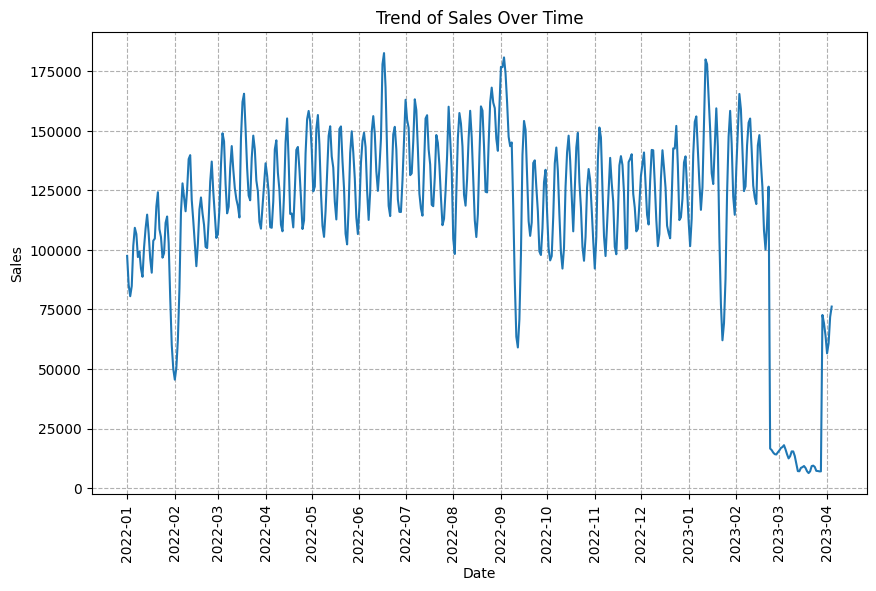

In [ ]:
daily_sales = train_df.resample('D', on='일자').mean()['판매금액']
plt.figure(figsize=(10, 6))
sns.lineplot(x=daily_sales.index, y=daily_sales.values)
plt.title('Trend of Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())
plt.show()

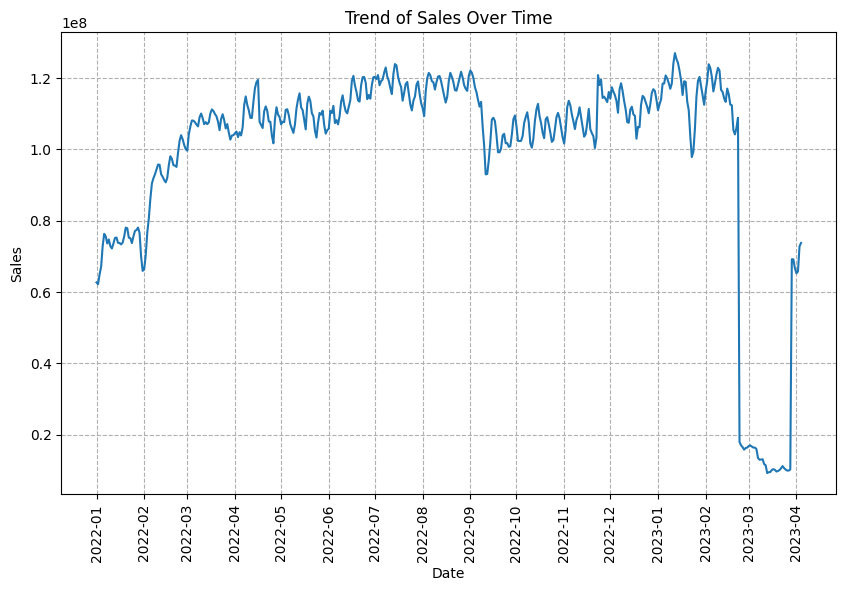

In [ ]:
daily_sales = train_df.resample('D', on='일자').sum()['평균판매금액']
plt.figure(figsize=(10, 6))
sns.lineplot(x=daily_sales.index, y=daily_sales.values)
plt.title('Trend of Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())
plt.show()

## ○ (대,중,소)분류 계층 구조

**배경**

- 제품이 너무 많아 하나하나 확인할 수 없음

- 비슷한 제품은 같은 분류로 묶임

- 분류별 경향성을 확인하기 위해 어떤 구조로 분류가 되는지 확인


**요약**

- 중분류 'B002-C002-0009' 는 여러 대분류에 속해있음

- 소분류는 다 잘 나뉘어져 있음

In [ ]:

for big in sorted(original_df['대분류'].unique()):
    print(f'\n-{big}')
    for middle in sorted(original_df['중분류'].unique()):
        hierarchy = original_df[((original_df['대분류']==big) * (original_df['중분류']==middle)==1)]['소분류'].unique()
        if (len(hierarchy)>0):
            print(f'--{middle}')
            print(sorted(hierarchy))



-B002-C001-0001
--B002-C002-0001
['B002-C003-0001', 'B002-C003-0002', 'B002-C003-0003', 'B002-C003-0004', 'B002-C003-0005']
--B002-C002-0009
['B002-C003-0051']

-B002-C001-0002
--B002-C002-0002
['B002-C003-0006', 'B002-C003-0007', 'B002-C003-0008', 'B002-C003-0009', 'B002-C003-0010', 'B002-C003-0011']
--B002-C002-0003
['B002-C003-0012', 'B002-C003-0013', 'B002-C003-0014', 'B002-C003-0015', 'B002-C003-0016', 'B002-C003-0017', 'B002-C003-0018']
--B002-C002-0004
['B002-C003-0019', 'B002-C003-0020', 'B002-C003-0021', 'B002-C003-0022', 'B002-C003-0023']
--B002-C002-0005
['B002-C003-0024', 'B002-C003-0025', 'B002-C003-0026', 'B002-C003-0027', 'B002-C003-0028', 'B002-C003-0029', 'B002-C003-0041']
--B002-C002-0006
['B002-C003-0030', 'B002-C003-0031', 'B002-C003-0032', 'B002-C003-0033', 'B002-C003-0034']
--B002-C002-0007
['B002-C003-0035', 'B002-C003-0036', 'B002-C003-0037', 'B002-C003-0038', 'B002-C003-0039', 'B002-C003-0040']
--B002-C002-0009
['B002-C003-0045', 'B002-C003-0046', 'B002-C003-0

## ○ 제품 특성 분석 및 카테고리화(★★)

**배경**

- 분류별 계층을 통해 트리구조와 비슷한 구조를 가지고 있음을 확인 하였음

- 각 분류별 특징을 확인하기 위해 제품 특성을 확인해 분류 기준을 정의

**요약**

- 각 분류별 특징을 파악할 수 있음

- 각 소분류에 해당하는 제품들 중에 적절하지 못한 제품 특성을 가진 제품이 존재


### 대분류
**요약**

- B002-C001-0001' (건강식품)

- B002-C001-0002 (주방,화장실,세탁 용품)[중간에 유아용 선크림 포함

- B002-C001-0003 (유아용품)

- B002-C001-0004 (선크림)

- B002-C001-0005 (식사식품)[주로 유아용이 자주 보임


### 중분류
**요약**

- B002-C002-0001 건강식품

- B002-C002-0002 주방용품

- B002-C002-0003 세탁용품

- B002-C002-0004 양치

- B002-C002-0005 휴지류,깔개매트,기저귀류 [구미/젤리가 있는걸로 봐서는 제대로 봐야할 듯]

- B002-C002-0006 면도

- B002-C002-0007 샴푸 [ 종류에 속눈썹펌제 OLED 확인]

- B002-C002-0008 유아식사용품

- B002-C002-0009 유아용 세탁,양치,건강

- B002-C002-0010 로션류 [급여방식에 사료라고 되어있음]

- B002-C002-0011 유아용 식사 음료 간식 [퍼프가 있다 확인해볼것]



### 소분류
**요약**


B002-C003-0001: 체지방 감소, 단백질, 게이너 등 보이는 것으로 보아 헬스케어 식품인 듯 함

B002-C003-0002: 비타민

B002-C003-0003: 건강기능 식품

B002-C003-0004: 프로틴

B002-C003-0005: 홍삼

B002-C003-0006: 방향제

B002-C003-0007: 진짜 짐작 안됨

B002-C003-0008: 짐작 어려움

B002-C003-0009: 수세미

B002-C003-0010: 키친 타월

B002-C003-0011: 제습제

B002-C003-0012: 청소용세제

B002-C003-0013: 건조기 스타일러 시트?

B002-C003-0014: 섬유유연제

B002-C003-0015: 세탁세제

B002-C003-0016: 주방세제

B002-C003-0017: 베이킹소다 과탄산소다 등

B002-C003-0018: 표백제

B002-C003-0019: 치약

B002-C003-0020: 성인용 칫솔

B002-C003-0021: 치실

B002-C003-0022: 아동용 치약

B002-C003-0023: 아동용 칫솔

B002-C003-0024: 롤휴지

B002-C003-0025: 물티슈

B002-C003-0026: 휴지

B002-C003-0027: 생리대

B002-C003-0028: 요실금용 기저귀, 패드

B002-C003-0029: 휴지류

B002-C003-0030: 면도, 면도날 (153개인데 카테고리가 13개만 추출됨)

B002-C003-0031: 쉐이빙폼

B002-C003-0032: 핸드워시 바디솝? (저자극)

B002-C003-0033: 전동 면도기

B002-C003-0034: 신체 전체 로션

B002-C003-0035: 샴푸

B002-C003-0036: 샴푸

B002-C003-0037: 샴푸

B002-C003-0038: 샴푸

B002-C003-0039: 샴푸

B002-C003-0040: 샴푸

B002-C003-0041: 소아용 기저귀

B002-C003-0042: 젖병 세척 관련

B002-C003-0043: 젖병, 착유기

B002-C003-0044: 유아 식기

B002-C003-0045: 보습제?

B002-C003-0046: 유아용 샤워용품

B002-C003-0047: 선크림 (대부분 유아용)

B002-C003-0048: 세제

B002-C003-0049: 유아용 칫솔, 치실

B002-C003-0050: 피부 로션 (유아용이 아닐 것으로 추측, 중간에 사료처럼 보이는 특징 하나 존재)

B002-C003-0051: 분유

B002-C003-0052: 신생아 식품, 간식류 (음료, 과자)

B002-C003-0053: 신생아 식품, 식사류



In [ ]:
product_info_df.head(10)

,제품,제품특성
0,B002-03509-00001,제품유형:일반식품 콜라겐 펩타이드:1000mg 종류:어류 분자량:300Da 섭취대상...
1,B002-02376-00001,700mg x 28정
2,B002-03735-00001,제품타입:정 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 두 번 1일 총 섭...
3,B002-03735-00003,제품타입:정 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 한 번 1일 총 섭...
4,B002-02769-00001,HCA:900mg 영양소 원료명(식약처고시):비타민B1 영양소 원료명(식약처고시):...
5,B002-02769-00002,제품유형:일반식품 섭취대상:성인남녀 제품타입:액상 제품용량:7일분 섭취횟수:하루 한...
6,B002-03432-00001,섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 두 번 1일 총 섭취량:2포 제...
7,B002-01075-00001,"제품타입섭취방법섭취대상섭취횟수1일 총 섭취량제품용량주요 기능성(식약처인증):정, 생..."
8,B002-02925-00001,제품타입:캡슐 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 한 번 1일 총 ...
9,B002-00771-00001,HCA:800mg 영양소 원료명(식약처고시):비타민B1 영양소 원료명(식약처고시):...


### 제품특성 열을 이용한 내용 파싱



In [ ]:
#특성 구분과 특성 내용 파싱

result = product_info_df.copy()
used_key = {}
for j in tqdm.tqdm(range(len(product_info_df))):
    tmp = product_info_df.loc[j]['제품특성']

    v_start = 0
    v_end = 0
    k = ""
    v = ""
    k_mode = 0 #0이면 k
    for i in range(len(tmp)):
        if tmp[i] ==',':
            v_start = i+1
            v_end = i+1
        if tmp[i] ==':' :
            if (v_end>v_start):
                v = tmp[v_start:v_end]
                if (len(k)<=15 and k != ''):
                    if k not in result:
                        result[k] = ' '
                    result[k][j]= v
            k = tmp[v_end:i]
            v_start = i+1
        elif tmp[i] == ' ':
            v_end = i+1



100%|██████████| 12778/12778 [14:21<00:00, 14.84it/s]


In [ ]:
# 추출한 특성 카테고리 중에 Unique 값이 세개 이상인 것
# 3개가 기준인 이유는 Null 값이 ' ' 이기 때문에 이를 제외한 구분되는 값이 두개 이상인 경우를 위해서
# 예시 -> 본품 리필
summation = 0
for i in result.columns[8:]:
    if ( len(result[i].unique())>=3 ):
        for j in result[i].unique():
            print(i,':', j)
            summation+=1

print(summation)

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
제품용량 : 5개월분 1일 총 
제품용량 : 70일분 
제품용량 : 10개월분 
제품용량 : 임산부 1일 총 
제품용량 : 2정 
제품용량 : 1개월분 주요 기능성(식약처인증)_A영양소 
제품용량 : 1개월분 영양소 원료명(식약처고시)_A영양소 원료명(식약처고시)_A영양소 
제품용량 : 1200mg 1일 총 
제품용량 : 20일분 영양소 
제품용량 : 씹어서 
제품용량 : 3일분 
제품용량 : 80일분 1일 총 
제품용량 : 80일분 
제품용량 : 28일분 영양소 
제품용량 : 물에 섞어서 
제품용량 : 4정 
제품용량 : 하루 두 번 
제품용량 : 하루 세 번 
제품용량 : 75일분 
제품용량 : 7일분 1일 총 
제품용량 : 바로 음용 
제품용량 : 1캡슐 
제품용량 : 6개월분 주요 
제품용량 : 1스푼 
제품용량 :  식품품질인증제품타입섭취방법섭취대상섭취횟수1일 총 섭취량제품용량주요 기능성(식약처인증)영양소 
제품용량 : 56일분 주요 
제품용량 : 12개월분 1일 총 
제품용량 : 35일분 
제품용량 : 100일분 1일 총 
제품용량 : 비타민E 1일 총 
제품용량 : 4개월분 영양소 
제품용량 : 1캡슐 주요 
제품용량 : 56일분 영양소 
제품용량 :  포장형태제품용량섭취횟수1일 총 
제품용량 : 유아/청소년 
제품용량 : 12개월분 
제품용량 : 9일분 
제품용량 : 100일분 영양소 원료명(식약처고시)_A영양소 원료명(식약처고시)_A영양소 
제품용량 : 3개월분 영양소 
제품용량 : 5개월분 영양소 
제품용량 : 3정 주요 
제품용량 : 개인별 다름 1일 총 
제품용량 : 3캡슐 주요 
제품용량 : 개인별 다름 영양소 
제품용량 : 10일분 영양소 
제품용량 : 80일분 주요 
제품용량 : 1포 주요 
제품용량 : 수시로 
제품용량 : 10일분 1일 총 
제품용량 : 2캡슐 
섭취횟수 : 하루 한 번 1일 총 
섭취횟수 :  
섭취횟수 : 하루 두 번 1일 총 
섭취횟수 : 하루 

### 파싱한 특성 카테고리가 정상인지 확인

**요약**

- 제품 특성에는 갑티슈 종류라고 되어있는데 존재하지 안되는 CPU 특성이 존재한다.

-> 제품 특성 추출에 문제가 있었는지 해당 제품 특성을 정확히 분석하자

In [ ]:
# 일부 특성 카테고리를 통해 Null(' ')값이 아닌 값을 확인
result[result['CPU']!= ' ' ]

,제품,제품특성,제품유형,펩타이드,종류,분자량,섭취대상,제품타입,제품용량,섭취횟수,...,세부제품특징용량:고정력,제품형태세부제품특징용량:젤형,안마부위,강약조절,충전시간:2시간,충전시간:3시간,교체용헤드:4개,교체용헤드:8개,무선충전패드,칫솔모2종
10126,B002-03786-00019,종류:갑티슈 매수:200매 특징:천연펄프 특징:무향 특징:무형광 특징:무인쇄 :1팩...,,,갑티슈,,,,,,...,,,,,,,,,,
10682,B002-03569-00001,EMF인증(전자파안심):전자파안심 용도:침대용 세탁:세탁가능 세탁:드럼세탁기사용가능...,,,,,,,,,...,,,,,,,,,,


In [ ]:
result[result['CPU']!= ' ' ]

,제품,제품특성,제품유형,펩타이드,종류,분자량,섭취대상,제품타입,제품용량,섭취횟수,...,노즐소재,비데종류,세트구성세트구성,연령연령연령재질(젖병),종류용량,제품타입섭취방법,세부제품특징용량,안마부위,강약조절,교체용헤드
10126,B002-03786-00019,종류:갑티슈 매수:200매 특징:천연펄프 특징:무향 특징:무형광 특징:무인쇄 :1팩...,,,갑티슈,,,,,,...,,,,,,,,,,
10682,B002-03569-00001,EMF인증(전자파안심):전자파안심 용도:침대용 세탁:세탁가능 세탁:드럼세탁기사용가능...,,,,,,,,,...,,,,,,,,,,


### 'B002-03786-00019' 제품 특성 상세 분석

**요약**

제품 특성이 ','를 기준으로 여러개의 종류의 물품으로 구분이 되는 것을 확인했다.
1. 갑티슈

2. 노트북 종류인 듯 하다.

3. 2와 동일

4. 2와 동일

**가정**

- 제품코드가 동일한 다른 제품이 존재한다.

In [ ]:
result[result['CPU']!= ' ' ]['제품특성'].values[0].split(',')

['종류:갑티슈 매수:200매 특징:천연펄프 특징:무향 특징:무형광 특징:무인쇄 :1팩',
 ' 화면크기:10인치(25.4cm) 인터넷연결:4G(LTE)+WiFi 램(RAM):8GB 형태:패드형 SSD:128GB 출시OS:윈도우10S CPU:펜티엄 골드 4415Y 그래픽:HD615 외장메모리:microSD 코어:듀얼 터치:마우스지원(별매) 해상도:1800x1200 부가기능:윈도Hello 사용시간:9시간 칩셋 제조사:인텔 블루투스:블루투스 4.1 무선랜:Wi-Fi5 단자:USB(Type C) 단자:서피스커넥트 카메라화소(전면):500만 무게:522g 두께:8.3mm 가로:243mm 세로:175mm 펜:서피스펜(별매) 키보드:전용키보드 별매 카메라화소(후면):800만 ppi:217ppi :정품',
 ' 화면크기:10인치(25.4cm) 내장메모리:64GB 인터넷연결:WiFi전용 램(RAM):4GB 형태:패드형 출시OS:윈도우10S CPU:펜티엄 골드 4415Y 그래픽:HD615 외장메모리:microSD 코어:듀얼 터치:마우스지원(별매) 디스플레이 특징:터치스크린 해상도:3:2 해상도:217ppi 해상도:1800x1200 부가기능:윈도Hello 사용시간:9시간 칩셋 제조사:인텔 블루투스:블루투스 4.1 무선랜:Wi-Fi5 단자:USB(Type C) 단자:서피스커넥트 카메라화소(전면):500만 무게:522g 두께:8.3mm 부피:355cc 가로:243mm 세로:175mm 펜:서피스펜(별매) 키보드:전용키보드 별매 카메라화소(후면):800만',
 ' 화면크기:10인치(25.4cm) 인터넷연결:WiFi전용 램(RAM):8GB 형태:패드형 SSD:128GB 출시OS:윈도우10S CPU:펜티엄 골드 4415Y 그래픽:HD615 외장메모리:microSD 코어:듀얼 터치:마우스지원(별매) 디스플레이 특징:터치스크린 해상도:3:2 해상도:217ppi 해상도:1800x1200 부가기능:윈도Hello 사용시간:9시간 칩셋 제조사:인텔 블루투스:블루투스 4.1 무선랜:Wi-Fi5 단자:

### 중복 제품 여부 확인

**요약**

- 검색결과 행이 하나가 나오므로 해당 제품에는 중복된 제품이 없으며 제품 특성 중 일부만이 진짜 특성임

In [ ]:
original_df[original_df['제품'] == 'B002-03786-00019'].head()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
15799,15799,B002-03786-00019,B002-C001-0002,B002-C002-0005,B002-C003-0026,B002-03786,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### 제품의 정확한 특성을 확인하기 위한 소분류 'B002-C003-0026'에 속하는 제품들의 제품특성 확인

*요약*

- 소분류 'B002-C003-0026'는 티슈, 키친타월 등의 제품인 것으로 판별

- 제품 특성에 불필요한 정보가 섞임을 알 수 있었다.


*가정*

- 제품 특성 중에 ','기준 맨 처음  제품 특성만 특정이 되는 것인가?

-> 위의 제품 특성 카테고리 추출 알고리즘에서 ,가 발견되면 break하고 ,가 발견된 위치가 적절한지 살펴보자(제품특성의 카테고리 설명에 ','가 있을 수 있기때문)


In [ ]:
original_df_with_product_info[original_df_with_product_info['소분류']=='B002-C003-0026']['제품특성'].unique()

array(['종류:갑티슈 매수:280매 겹수:2겹 특징:천연펄프 특징:푸쉬업 특징:무향 특징:무형광 특징:무색소 :1팩, 매수:200매 겹수:2겹 특징:천연펄프 :1팩, 종류:갑티슈 매수:230매 겹수:2겹 특징:천연펄프 특징:푸쉬업 특징:무향 특징:무형광 특징:무색소 :1팩, 겹수:2겹 특징:천연펄프 특징:푸쉬업 특징:무향 특징:무형광 특징:무색소 :1팩, 매수:180매 :1팩 280매',
       '매수:200매 겹수:2겹 특징:천연펄프 :1팩, 매수:180매 :1팩 200매',
       '종류:갑티슈 매수:230매 겹수:2겹 특징:천연펄프 특징:무형광 특징:무포름 250매',
       '종류:갑티슈 매수:230매 겹수:2겹 특징:천연펄프 특징:무형광 :2팩 230매 6입',
       '종류:갑티슈 매수:250매 겹수:2겹 특징:천연펄프 특징:무형광 :1팩 250매',
       '매수:180매 :1팩, 매수:200매 :1팩, 종류:갑티슈 매수:230매 겹수:2겹 특징:천연펄프 특징:무형광 특징:무포름 200매',
       '겹수:2겹 특징:천연펄프 특징:푸쉬업 특징:무향 특징:무형광 특징:무색소 :1팩 250매',
       '겹수:2겹 특징:천연펄프 특징:푸쉬업 특징:무향 특징:무형광 특징:무색소 :1팩 230매',
       '종류:갑티슈 매수:180매 겹수:2겹 특징:천연펄프 특징:무형광 특징:무포름 사이즈:일반 :3팩 180매',
       '종류:갑티슈 매수:250매 겹수:2겹 롤수:6롤 특징:천연펄프 :2팩 250매 x 6입',
       '종류:갑티슈 매수:180매 겹수:2겹 특징:천연펄프 특징:무향 특징:무형광 특징:무색소 특징:데코엠보싱 :1팩, 종류:갑티슈 매수:180매 겹수:2겹 특징:천연펄프 특징:무향 특징:무형광 특징:무색소 특징:데코엠보싱 :1팩 2겹 180매',
       '종류:갑티슈 매수:250매 겹수:2겹 특징:천연펄프 특징:무향 특징:무형광 특징:무색소 특징:데코엠보싱 :1팩 2겹 250매'

### 특성 추출 알고리즘 수정

**요약**

- 추가적인 필터링 없이도 더 깔끔한 추출 결과를 보여줌

- 추출 시간 크게 단축

In [ ]:
result = product_info_df.copy()
used_key = {}
comma_list = []
for j in tqdm.tqdm(range(len(product_info_df))):
    tmp = product_info_df.loc[j]['제품특성']

    v_start = 0
    v_end = 0
    k = ""
    v = ""
    k_mode = 0 #0이면 k
    for i in range(len(tmp)):
        if tmp[i] == ',':
            comma_list.append(j)
            break
        if tmp[i] ==':':
            if (v_end>v_start):
                v = tmp[v_start:v_end]
                if (len(k)<=15 and k != ''):
                    if k not in result:
                        result[k] = ' '
                    result[k][j]= v
            k = tmp[v_end:i]
            v_start = i+1
        elif tmp[i] == ' ':
            v_end = i+1

100%|██████████| 12778/12778 [01:24<00:00, 152.01it/s]


In [ ]:
summation = 0
for i in result.columns[8:]:
    if ( len(result[i].unique())>=3 ):
        for j in result[i].unique():
            if j!=' ':
                summation+=1
                print(i,j)

print(summation)

제품용량 3개월분 
제품용량 14일분 주요 
제품용량 2개월분 
제품용량 28일분 
제품용량 7일분 
제품용량 15일분 주요 
제품용량 1개월분 주요 
제품용량 1개월분 
제품용량 6개월분 
제품용량 정 
제품용량 14일분 
제품용량 15일분 
제품용량 56일분 
제품용량 분말 
제품용량 1포 
제품용량 10일분 
제품용량 45일분 
제품용량 50일분 
제품용량 구미/젤리 
제품용량 12일분 
제품용량 개인별 다름 
제품용량 28일분 주요 
제품용량 정 1일 총 
제품용량 3개월분 주요 
제품용량 7일분 주요 
제품용량 10일분 주요 
제품용량 성인남녀 
제품용량 하루 한 번 
제품용량 2포 
제품용량 5일분 
제품용량 6개월분 주요 
제품용량 25일분 
제품용량 100일분 
제품용량 하루 두 번 
제품용량 2스푼 
제품용량 20일분 주요 
제품용량 개인별 다름 주요 
제품용량 2개월분 주요 
제품용량 35일분 주요 
제품용량 40일분 
제품용량 21일분 
제품용량 1개월분 영양소 원료명(식약처고시)_A영양소 
제품용량 15일분 영양소 
제품용량 21일분 1일 총 
제품용량 1개월분 1일 총 
제품용량 3개월분 1일 총 
제품용량 3개월분 영양소 
제품용량 45일분 1일 총 
제품용량 50일분 1일 총 
제품용량 2개월분 1일 총 
제품용량 9개월분 
제품용량 3개월분 주요 기능성(식약처인증)_A영양소 
제품용량 28일분 1일 총 
제품용량 20개월분 
제품용량 6개월분 1일 총 
제품용량 14개월분 1일 총 
제품용량 2개월분 영양소 
제품용량 4개월분 
제품용량 20일분 1일 총 
제품용량 20일분 
제품용량 100일분 영양소 
제품용량 1개월분 영양소 
제품용량 200일분 
제품용량 70일분 
제품용량 8개월분 
제품용량 4개월분 1일 총 
제품용량 70일분 1일 총 
제품용량 100일분 1일 총 
제품용량 15일분 1일 총 
제품용량 45일분 주요 
제품용량 개인별 다름 영양소 
제품용량 50일분 주요 
제품용량 100일분 주요 
제품용량 75일분 1일

### 추출된 특성 이진화

*분석단계*

1. 각 소분류별 카테고리 중 Null(' ')값이 아닌 개수 점으로 표현

2. 그래프를 보고 적절한 카테고리 수 n을 지정하여 상위 n개 카테고리명 추출

3. 해당 카테고리의 unique 속성들을 보며 소분류의 특성 파악

In [ ]:
tmp_original = pd.merge(original_df.drop(original_df.columns[6:],axis=1), result, on=['제품'], how='left').fillna(' ')
tmp = tmp_original
tmp.head()
def replace_empty_with_values(value):
    if value == ' ':
        return 0
    else:
        return 1
tmp = tmp.applymap(replace_empty_with_values)

### 추출된 특성을 기반으로 대분류별 특성 분석

#### 1단계

**요약**

- 각 소분류 별 주요하게 나타나는 항목들이 존재

- 상위 10개 정도면 충분히 표현 가능

-> 소분류별 상위 10개 항목에 대한 특성들 표현할 것

In [ ]:


plt.figure(figsize=(30, 50))
for i in range(len(data_summation)):
    plt.subplot(len(data_summation)//4+1,4,i+1)
    data = data_summation.iloc[i]

    sns.scatterplot(x=data.index, y=data.values)

    plt.title(data_summation.index[i])
plt.show()

#### 2단계

In [ ]:
data_summation = tmp.groupby('대분류').sum()
def top_n_columns(row, n):
    max_values = row.nlargest(n)
    return max_values.index, max_values.values
n = 50
data_summation['top_columns'], data_summation['top_values'] = zip(*data_summation.apply(lambda row: top_n_columns(row, n), axis=1))


#### 3단계

**요약**

- 각 소분류 별 어떤 제품을 나타내는지 확인 가능

In [ ]:

for i,item in  enumerate(data_summation['top_columns']):
    print(data_summation['top_columns'].index[i], len(original_df[original_df['대분류']==data_summation['top_columns'].index[i]]))


    for j in range(len(item.values)):
        print(item.values[j],"nunique", data_summation['top_values'][i][j])
        print(tmp_original[tmp_original['대분류'] ==data_summation['top_columns'].index[i]][item.values[j]].unique())
    print("-------------------------------------------------------------")


B002-C001-0001 3768
섭취방법 nunique 2373
[' ' '물과 함께 ' '씹어서 ' '물에 섞어서 1일 총 ' '바로 음용 ' '물에 섞어서 ' '물과 함께 주요 ' '1정 '
 '성인남녀 1일 총 ' '15g 1일 총 ' '커피 ' '성인남녀 ' '물과 함께 1일 총 ' '씹어서 주요 ' '3정 '
 '직접 분무 ' '1포 ' '하루 한 번 ' '6정 ' '바로 음용 주요 ' '바로 음용 1일 총 ' '하루 두 번 '
 '물과 함께 영양소 ' '씹어서 영양소 ' '물과 함께 주요 기능성(식약처인증)_A영양소 ' '직접 분무 주요 ' ' 주요 '
 '캡슐 ' '분말 ' '20g 1일 총 ' '2정 ' '아르기닌 1일 총 ' '환 ' '바로 음용 영양소 ' '물에 섞어서 주요 '
 '동물성 1일 총 ' '씹어서 1일 총 ' '바닐라 1일 총 ' '3개 ' '엽산 1일 총 ' '하루 한 번 주요 ' '곡물 '
 '구미/젤리 ' '초코 ' '복숭아 1일 총 ' '곡물 1일 총 ' '2개 ' '비오틴 ' '2포 ' '10g '
 '하루 두 번 주요 기능성(식약처인증)_A영양소 ' '비오틴 1일 총 ' '아연 1일 총 ' '쿠키 1일 총 ' '초코 1일 총 ']
섭취횟수 nunique 2325
[' ' '하루 한 번 ' '하루 한 번 1일 총 ' '하루 세 번 ' '하루 두 번 1일 총 ' '하루 두 번 '
 '수시로 1일 총 ' '2개월분 1일 총 ' '2스푼 ' '하루 한 번 제품용량_A영양소 ' '1개월분 1일 총 '
 '28일분 1일 총 ' '물에 섞어서 ' '구미/젤리 ' '42일분 1일 총 ' '수시로 ' '1정 ' '2캡슐 '
 '하루 세 번 1일 총 ' '성인남녀 1일 총 ' '1개 ' '1캡슐 ' '1포 ' '성인남녀 ' '2개 ' '분말 1일 총 '
 '2정 ' '2포 ' '하루 한 번 주요 ' '물과 함께 ' '1스푼 ' '액상 1일 총 ' '100일분 1일 총 ' '3정 '
 '바로 음용 ' '3스푼 ' '개인별 다름 1일 총

### 추출된 특성을 기반으로 중분류별 특성 분석

#### 1단계

**요약**

- 각 소분류 별 주요하게 나타나는 항목들이 존재

- 상위 10개 정도면 충분히 표현 가능

-> 소분류별 상위 10개 항목에 대한 특성들 표현할 것

In [ ]:

tmp = tmp.applymap(replace_empty_with_values)

tmp['중분류'] = original_df['중분류']
tmp.head()
tmp.drop(['ID','제품','대분류','소분류','브랜드','제품특성'],axis=1,inplace=True)
data_summation = tmp.groupby('중분류').sum()

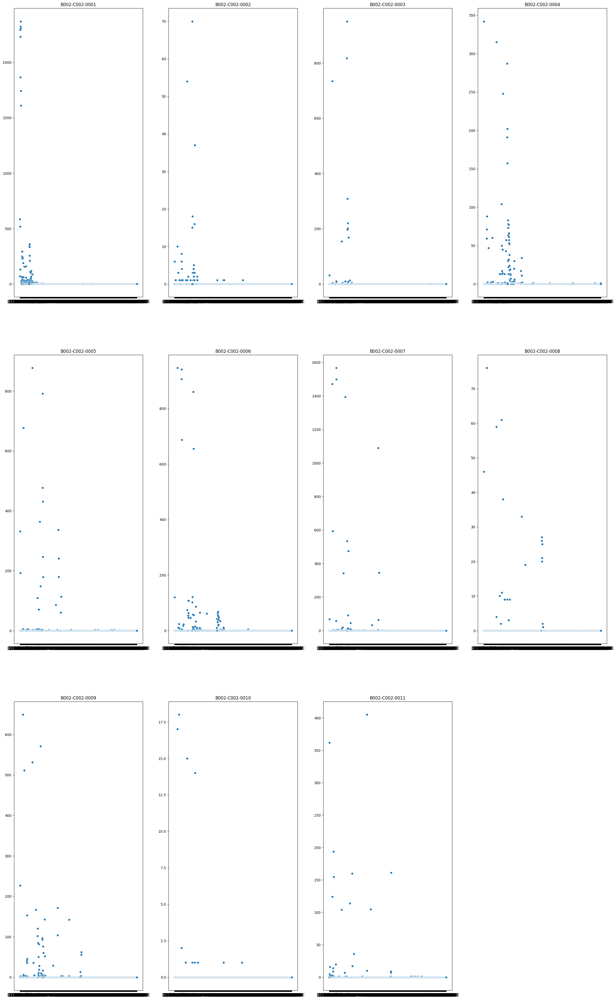

In [ ]:


plt.figure(figsize=(30, 50))
for i in range(len(data_summation)):
    plt.subplot(len(data_summation)//4+1,4,i+1)
    data = data_summation.iloc[i]

    sns.scatterplot(x=data.index, y=data.values)

    plt.title(data_summation.index[i])
plt.show()

#### 2단계

In [ ]:
data_summation = tmp.groupby('중분류').sum()
def top_n_columns(row, n):
    max_values = row.nlargest(n)
    return max_values.index, max_values.values
n = 30
data_summation['top_columns'], data_summation['top_values'] = zip(*data_summation.apply(lambda row: top_n_columns(row, n), axis=1))


#### 3단계

**요약**

- 각 소분류 별 어떤 제품을 나타내는지 확인 가능

In [ ]:

for i,item in  enumerate(data_summation['top_columns']):
    print(data_summation['top_columns'].index[i], len(original_df[original_df['중분류']==data_summation['top_columns'].index[i]]))


    for j in range(len(item.values)):
        print(item.values[j],"nunique", data_summation['top_values'][i][j])
        print(tmp_original[tmp_original['중분류'] ==data_summation['top_columns'].index[i]][item.values[j]].unique())
    print("-------------------------------------------------------------")


B002-C002-0001 3608
섭취방법 nunique 2371
[' ' '물과 함께 ' '씹어서 ' '물에 섞어서 1일 총 ' '바로 음용 ' '물에 섞어서 ' '물과 함께 주요 ' '1정 '
 '성인남녀 1일 총 ' '15g 1일 총 ' '커피 ' '성인남녀 ' '물과 함께 1일 총 ' '씹어서 주요 ' '3정 '
 '직접 분무 ' '1포 ' '하루 한 번 ' '6정 ' '바로 음용 주요 ' '바로 음용 1일 총 ' '하루 두 번 '
 '물과 함께 영양소 ' '씹어서 영양소 ' '물과 함께 주요 기능성(식약처인증)_A영양소 ' '직접 분무 주요 ' ' 주요 '
 '캡슐 ' '분말 ' '20g 1일 총 ' '2정 ' '아르기닌 1일 총 ' '환 ' '바로 음용 영양소 ' '물에 섞어서 주요 '
 '동물성 1일 총 ' '씹어서 1일 총 ' '바닐라 1일 총 ' '3개 ' '엽산 1일 총 ' '하루 한 번 주요 ' '곡물 '
 '구미/젤리 ' '초코 ' '복숭아 1일 총 ' '곡물 1일 총 ' '2개 ' '비오틴 ' '2포 ' '10g '
 '하루 두 번 주요 기능성(식약처인증)_A영양소 ' '비오틴 1일 총 ' '아연 1일 총 ' '쿠키 1일 총 ' '초코 1일 총 ']
섭취횟수 nunique 2323
[' ' '하루 한 번 ' '하루 한 번 1일 총 ' '하루 세 번 ' '하루 두 번 1일 총 ' '하루 두 번 '
 '수시로 1일 총 ' '2개월분 1일 총 ' '2스푼 ' '하루 한 번 제품용량_A영양소 ' '1개월분 1일 총 '
 '28일분 1일 총 ' '물에 섞어서 ' '구미/젤리 ' '42일분 1일 총 ' '수시로 ' '1정 ' '2캡슐 '
 '하루 세 번 1일 총 ' '성인남녀 1일 총 ' '1개 ' '1캡슐 ' '1포 ' '성인남녀 ' '2개 ' '분말 1일 총 '
 '2정 ' '2포 ' '하루 한 번 주요 ' '물과 함께 ' '1스푼 ' '액상 1일 총 ' '100일분 1일 총 ' '3정 '
 '바로 음용 ' '3스푼 ' '개인별 다름 1일 총

### 추출된 특성을 기반으로 소분류별 특성 분석

#### 1단계

**요약**

- 각 소분류 별 주요하게 나타나는 항목들이 존재

- 상위 10개 정도면 충분히 표현 가능

-> 소분류별 상위 10개 항목에 대한 특성들 표현할 것

In [ ]:


tmp['소분류'] = original_df['소분류']
tmp.head()
tmp.drop(['ID','제품','대분류','중분류','브랜드','제품특성'],axis=1,inplace=True)
data_summation = tmp.groupby('소분류').sum()

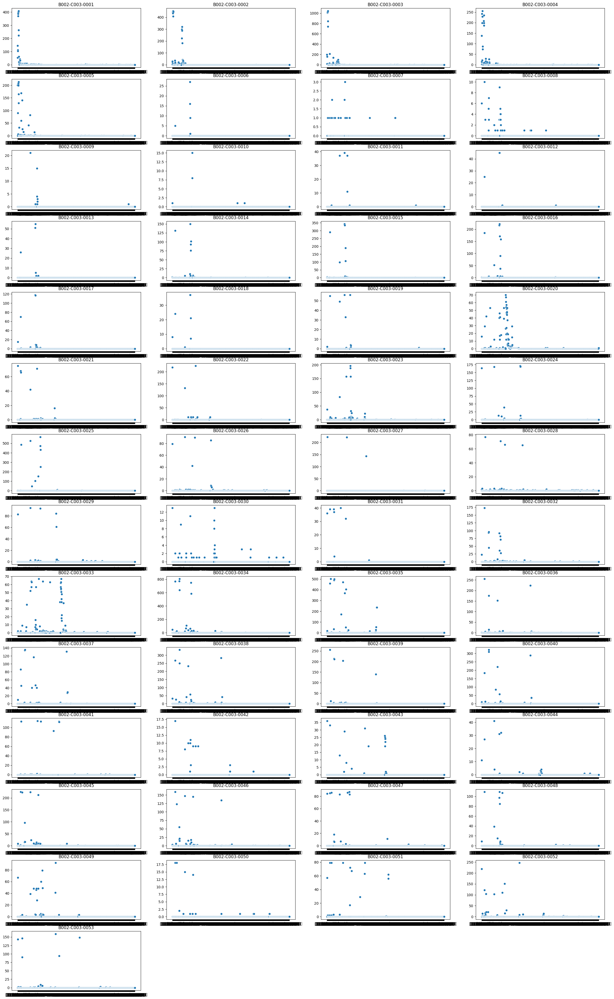

In [ ]:


plt.figure(figsize=(30, 50))
for i in range(len(data_summation)):
    plt.subplot(len(data_summation)//4+1,4,i+1)
    data = data_summation.iloc[i]

    sns.scatterplot(x=data.index, y=data.values)

    plt.title(data_summation.index[i])
plt.show()

#### 2단계

In [ ]:
data_summation = tmp.groupby('소분류').sum()
def top_n_columns(row, n):
    max_values = row.nlargest(n)
    return max_values.index, max_values.values
n = 15
data_summation['top_columns'], data_summation['top_values'] = zip(*data_summation.apply(lambda row: top_n_columns(row, n), axis=1))


#### 3단계

**요약**

- 각 소분류 별 어떤 제품을 나타내는지 확인 가능

In [ ]:

for i,item in  enumerate(data_summation['top_columns']):
    print(data_summation['top_columns'].index[i], len(original_df[original_df['소분류']==data_summation['top_columns'].index[i]]))


    for j in range(len(item.values)):
        print(item.values[j],"nunique", data_summation['top_values'][i][j])
        print(tmp_original[tmp_original['소분류'] ==data_summation['top_columns'].index[i]][item.values[j]].unique())
    print("-------------------------------------------------------------")


B002-C003-0001 751
섭취방법 nunique 408
['씹어서 ' ' ' '물과 함께 ' '물에 섞어서 1일 총 ' '1정 ' '바로 음용 ' '물에 섞어서 ' '성인남녀 ' '3정 '
 '1포 ' '6정 ' '물과 함께 주요 ' '분말 ' '2정 ' '환 ' '하루 한 번 ' '물과 함께 1일 총 ' '3개 '
 '구미/젤리 ' '바로 음용 1일 총 ' '2개 ' '비오틴 ' '물에 섞어서 주요 ']
섭취횟수 nunique 404
['하루 한 번 1일 총 ' ' ' '하루 한 번 ' '수시로 1일 총 ' '하루 세 번 ' '2개월분 1일 총 '
 '28일분 1일 총 ' '하루 두 번 1일 총 ' '하루 두 번 ' '1개월분 1일 총 ' '42일분 1일 총 '
 '하루 세 번 1일 총 ' '성인남녀 1일 총 ' '분말 1일 총 ' '액상 1일 총 ' '100일분 1일 총 '
 '개인별 다름 1일 총 ' '10일분 1일 총 ' '6개월분 1일 총 ' '판토텐산 ']
섭취량 nunique 400
['1포 ' ' ' '2캡슐 ' '2스푼 ' '3정 ' '2포 ' '하루 한 번 ' '어류 ' '2정 ' '1정 ' '물에 섞어서 '
 '1스푼 ' '4정 ' '6정 ' '2정 주요 ' '3개 ' '1캡슐 ' ' 제품타입제품용량섭취대상섭취횟수1일 총 ' '8정 '
 '1개 ' '하루 두 번 ' '1캡슐 주요 ' '5캡슐 ' '4스푼 ' '3스푼 ' '1개월분 ' '14일분 ' '4캡슐 '
 '6포 ' '1캡슐 제품용량_A주요 ' ' 주요 기능성(식약처인증)섭취대상제품타입제품용량섭취횟수1일 총 ' '28일분 ' '5정 '
 '3정 주요 ' '6스푼 ' '3포 ' '3캡슐 ' '비타민B2 ' '6정 주요 ']
섭취대상 nunique 392
['성인남녀 ' ' ' '300Da ' '비타민C ' '1000mg ' '500Da ' '성인여성 ' '어류 ' '성인남녀 주요 '
 '성인남성 ' '물과 함께 ' '성인남녀 1일 총 ' '1820Da ' '씹어서 ' '20g 

## ○ 제품의 중복 확인

**배경**

- 처음 train.csv를 열면 행의 수는 15890개인데 describe() 메서드의 출력 중 제품의 unique의 값은 15840개이다.

- 행의 수와 unique의 수가 다른 것은 동일한 제품이 존재한다는 것을 의미

**요약**

- 동일 제품을 구별하기 위해서는 소분류,브랜드 속성 필요하다 (소분류만 사용시 83개 행, 브랜드까지 할 경우 100개 행)

- 중복된 제품은 소분류 또는 브랜드가 다를 뿐 제품 특성은 동일하다

In [ ]:
# 제품의 모든 정보를 확인하기 위해 Original_df와 product_info_df를 조인
train_with_product_info = pd.merge(original_df, product_info_df, on=['제품'], how='left')


# 제품을 토대로 중복되는 값 확인
duplicates = train_with_product_info[train_with_product_info.duplicated(subset='제품', keep=False)]

# 일별 판매량 정보 삭제
duplicates.drop(duplicates.columns[6:-1],axis=1,inplace=True)
print(duplicates.shape)

# 중복 정보 표시
duplicates.head(10)

(100, 7)


,ID,제품,대분류,중분류,소분류,브랜드,제품특성
113,113,B002-00060-00002,B002-C001-0002,B002-C002-0003,B002-C003-0015,B002-00060,"형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁..."
114,114,B002-00060-00002,B002-C001-0002,B002-C002-0003,B002-C003-0018,B002-00060,"형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁..."
215,215,B002-00070-00009,B002-C001-0001,B002-C002-0001,B002-C003-0001,B002-00070,단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질...
216,216,B002-00070-00009,B002-C001-0001,B002-C002-0001,B002-C003-0004,B002-00070,단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질...
2439,2439,B002-00616-00003,B002-C001-0002,B002-C002-0007,B002-C003-0039,B002-00616,헤어타입:모든 모발용 제품형태:스프레이형 세부제품특징:고정력 용량:180ml(g) ...
2440,2440,B002-00616-00003,B002-C001-0002,B002-C002-0007,B002-C003-0039,B002-02656,헤어타입:모든 모발용 제품형태:스프레이형 세부제품특징:고정력 용량:180ml(g) ...
3072,3072,B002-00732-00001,B002-C001-0001,B002-C002-0001,B002-C003-0001,B002-00732,단백질종류:동물성+식물성 단백질:6g 맛:초코 :1개 17g
3073,3073,B002-00732-00001,B002-C001-0001,B002-C002-0001,B002-C003-0004,B002-00732,단백질종류:동물성+식물성 단백질:6g 맛:초코 :1개 17g
4468,4468,B002-01069-00001,B002-C001-0001,B002-C002-0001,B002-C003-0001,B002-01069,단백질:2.5g 1일 총 섭취량:1개 :1개 21g x 12개입
4469,4469,B002-01069-00001,B002-C001-0001,B002-C002-0001,B002-C003-0004,B002-01069,단백질:2.5g 1일 총 섭취량:1개 :1개 21g x 12개입


In [ ]:
same_product_character = duplicates.groupby(['제품','소분류'])['제품특성'].unique()
for i in range(len(same_product_character)):
    print(same_product_character.index[i],same_product_character.values[i])
print(len(same_product_character))

('B002-00060-00002', 'B002-C003-0015') ['형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁기유형:일반,드럼겸용 :1개 3kg']
('B002-00060-00002', 'B002-C003-0018') ['형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁기유형:일반,드럼겸용 :1개 3kg']
('B002-00070-00009', 'B002-C003-0001') ['단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질(ISP) 단백질:49g 섭취대상:성인남녀 맛:곡물 섭취방법:물에 섞어서 1일 총 섭취량:2스푼 섭취횟수:하루 한 번 제품용량:25일분 :1개 700g']
('B002-00070-00009', 'B002-C003-0004') ['단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질(ISP) 단백질:49g 섭취대상:성인남녀 맛:곡물 섭취방법:물에 섞어서 1일 총 섭취량:2스푼 섭취횟수:하루 한 번 제품용량:25일분 :1개 700g']
('B002-00616-00003', 'B002-C003-0039') ['헤어타입:모든 모발용 제품형태:스프레이형 세부제품특징:고정력 용량:180ml(g) :1개, 헤어타입:모든 모발용 제품형태:스프레이형 주요제품특징:세팅력 주요제품특징:분사력 세부제품특징:고정력 용량:180ml(g) :1개 180g']
('B002-00732-00001', 'B002-C003-0001') ['단백질종류:동물성+식물성 단백질:6g 맛:초코 :1개 17g']
('B002-00732-00001', 'B002-C003-0004') ['단백질종류:동물성+식물성 단백질:6g 맛:초코 :1개 17g']
('B002-01069-00001', 'B002-C003-0001') ['단백질:2.5g 1일 총 섭취량:1개 :1개 21g x 12개입']
('B002-01069-00001', 'B002-C00

In [ ]:

same_product_character = duplicates.groupby(['제품','소분류','브랜드'])['제품특성'].unique()
for i in range(len(same_product_character)):
    print(same_product_character.index[i],same_product_character.values[i])
print(len(same_product_character))

('B002-00060-00002', 'B002-C003-0015', 'B002-00060') ['형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁기유형:일반,드럼겸용 :1개 3kg']
('B002-00060-00002', 'B002-C003-0018', 'B002-00060') ['형태:가루형 구성:리필 :1개, 형태:가루형 구성:리필 용량:1000ml(g) 세탁기유형:일반,드럼겸용 :1개 3kg']
('B002-00070-00009', 'B002-C003-0001', 'B002-00070') ['단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질(ISP) 단백질:49g 섭취대상:성인남녀 맛:곡물 섭취방법:물에 섞어서 1일 총 섭취량:2스푼 섭취횟수:하루 한 번 제품용량:25일분 :1개 700g']
('B002-00070-00009', 'B002-C003-0004', 'B002-00070') ['단백질종류:동물성+식물성 단백질성분:농축유청단백질(WPC) 단백질성분:분리대두단백질(ISP) 단백질:49g 섭취대상:성인남녀 맛:곡물 섭취방법:물에 섞어서 1일 총 섭취량:2스푼 섭취횟수:하루 한 번 제품용량:25일분 :1개 700g']
('B002-00616-00003', 'B002-C003-0039', 'B002-00616') ['헤어타입:모든 모발용 제품형태:스프레이형 세부제품특징:고정력 용량:180ml(g) :1개, 헤어타입:모든 모발용 제품형태:스프레이형 주요제품특징:세팅력 주요제품특징:분사력 세부제품특징:고정력 용량:180ml(g) :1개 180g']
('B002-00616-00003', 'B002-C003-0039', 'B002-02656') ['헤어타입:모든 모발용 제품형태:스프레이형 세부제품특징:고정력 용량:180ml(g) :1개, 헤어타입:모든 모발용 제품형태:스프레이형 주요제품특징:세팅력 주요제품특징:분사력 세부제품특징:고정력 용량:180ml(g) :1개 180g']
('B002-0

## ○ 대분류별 시간에 따른 판매량,판매금액 추이

**요약**

- 크게 볼 때 1,2,3,5번째 대분류가 비슷한 경향성

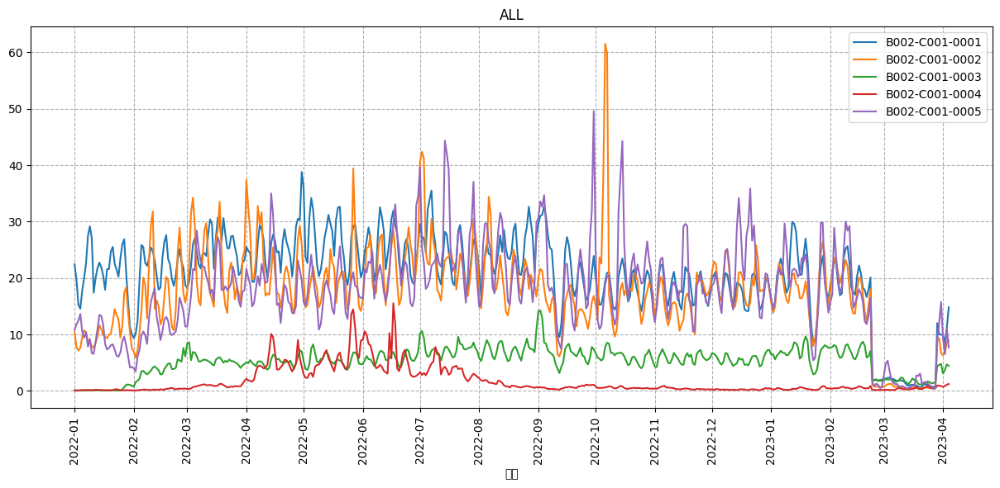

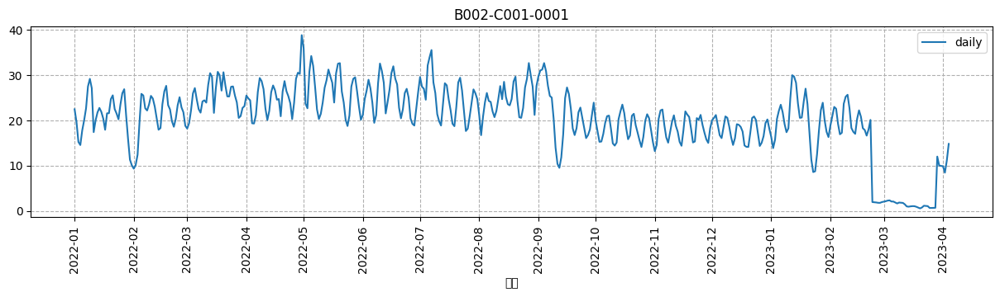

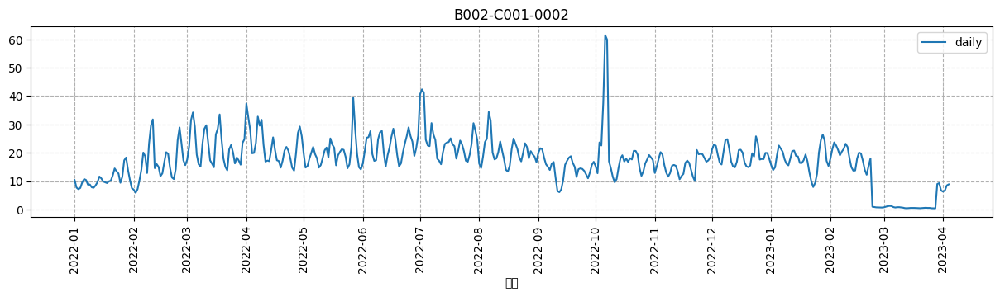

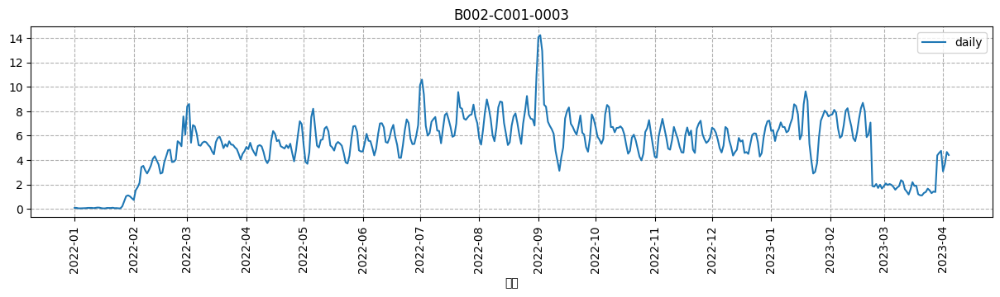

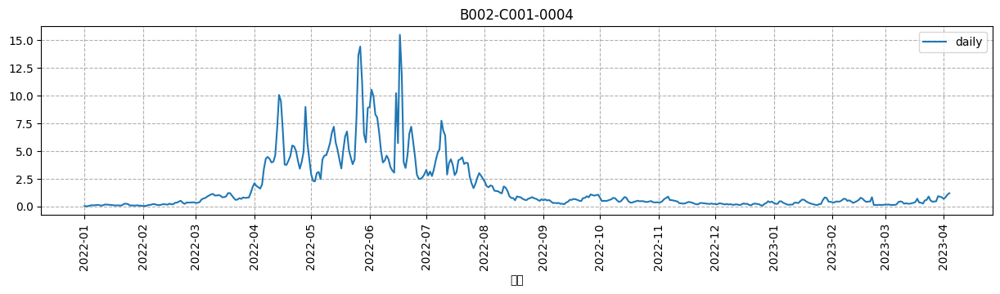

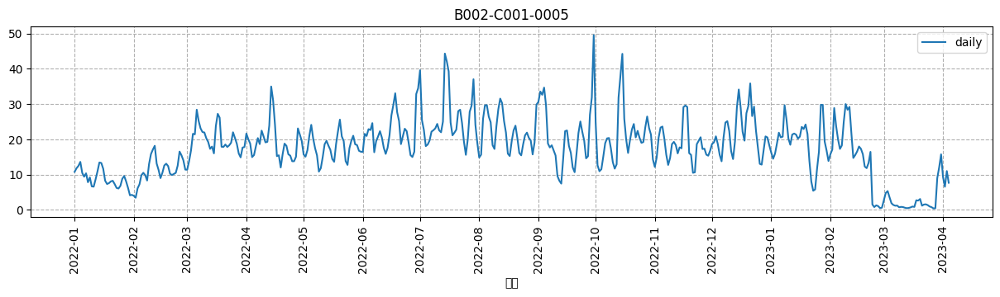

In [ ]:

data_summation = train_df.groupby(['대분류','일자']).mean().reset_index()
plt.figure(figsize=(15, 6))
for i,item in enumerate(sorted(original_df['대분류'].unique())):

    data = data_summation[data_summation['대분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매량'].values,label=item)



    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()


for i,item in enumerate(sorted(original_df['대분류'].unique())):
    plt.figure(figsize=(15, 3))

    data = data_summation[data_summation['대분류']==item]


    sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
    plt.show()



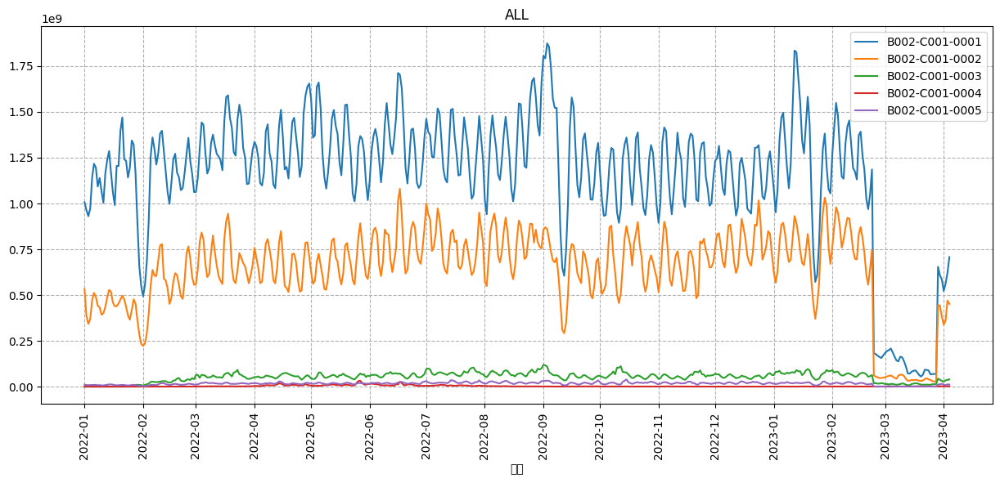

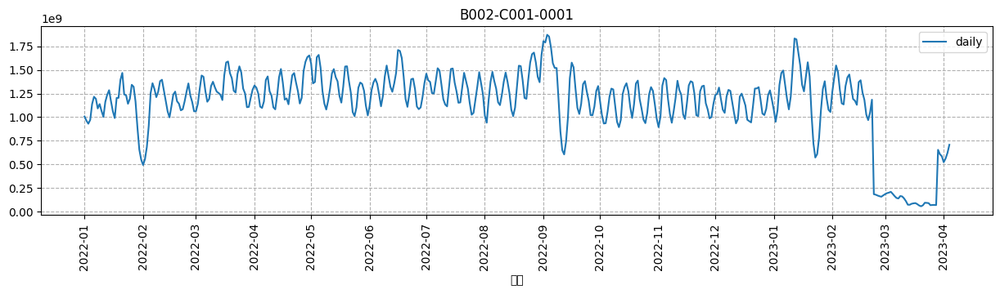

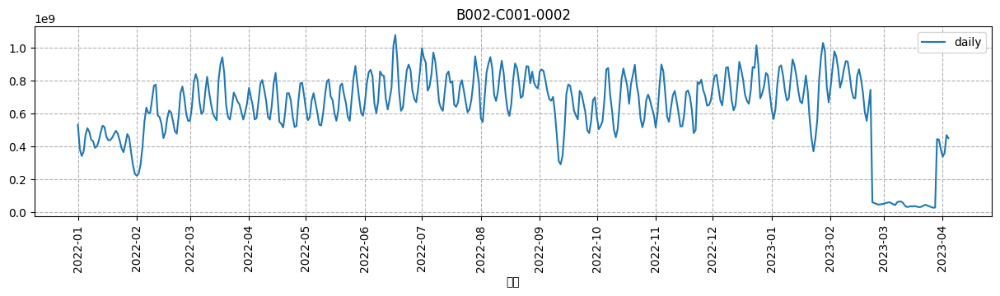

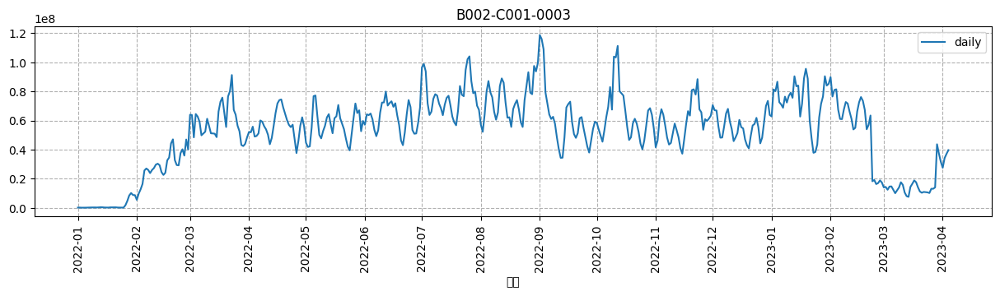

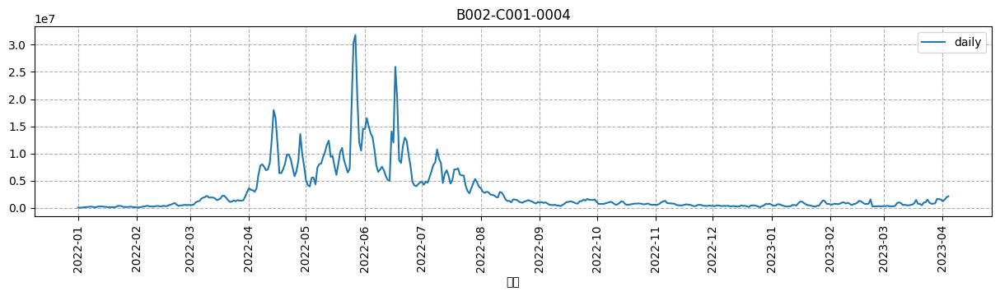

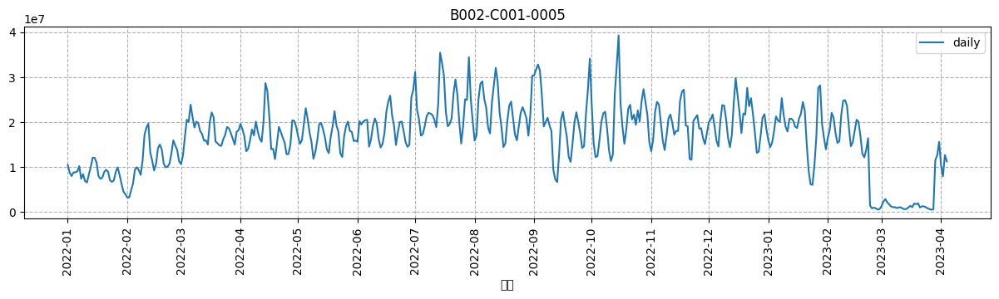

In [ ]:

data_summation = train_df.groupby(['대분류','일자']).sum().reset_index()
plt.figure(figsize=(15,6))
for i,item in enumerate(sorted(original_df['대분류'].unique())):

    data = data_summation[data_summation['대분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label=item)

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()


for i,item in enumerate(sorted(original_df['대분류'].unique())):
    plt.figure(figsize=(15, 3))

    data = data_summation[data_summation['대분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
    plt.show()

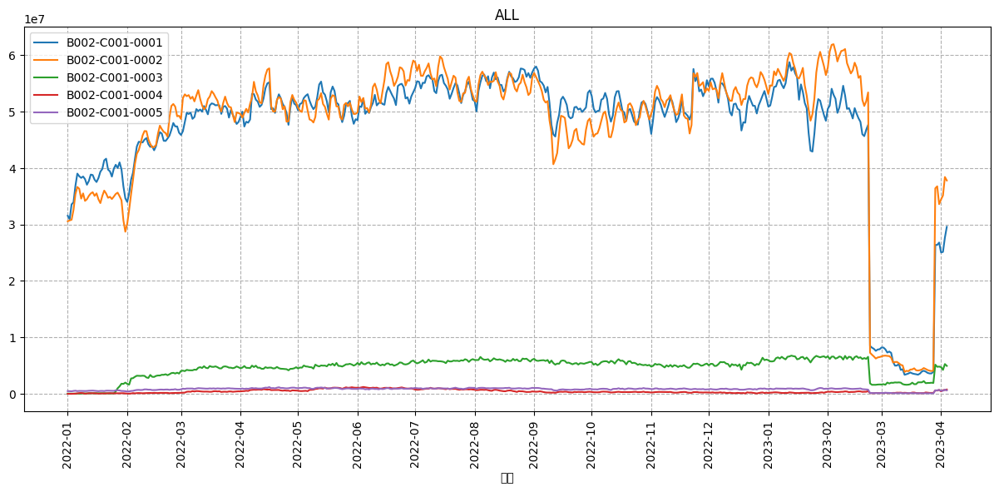

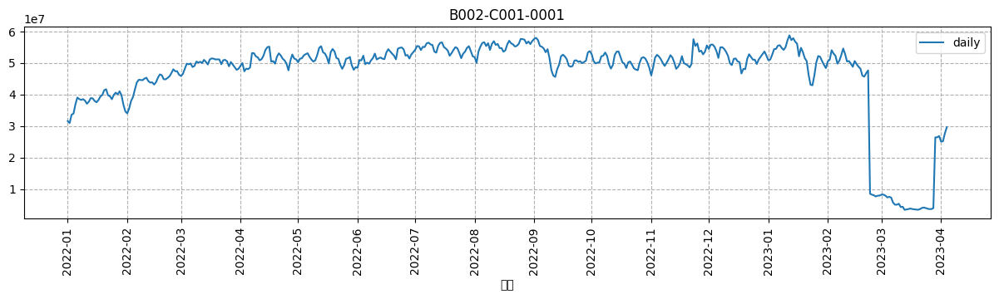

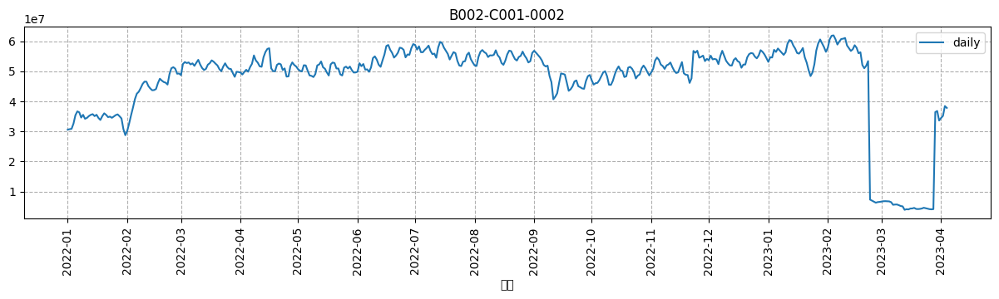

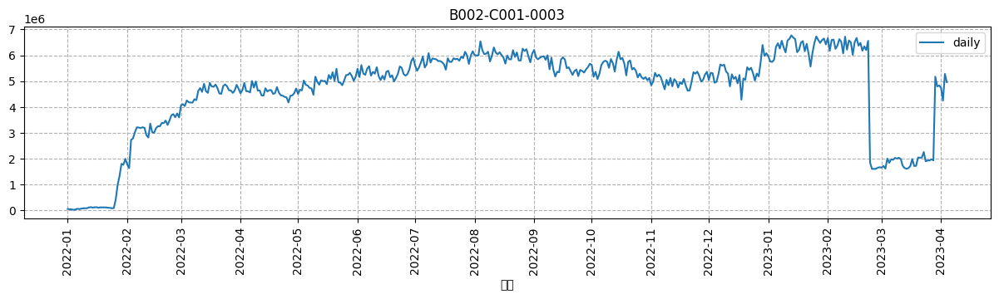

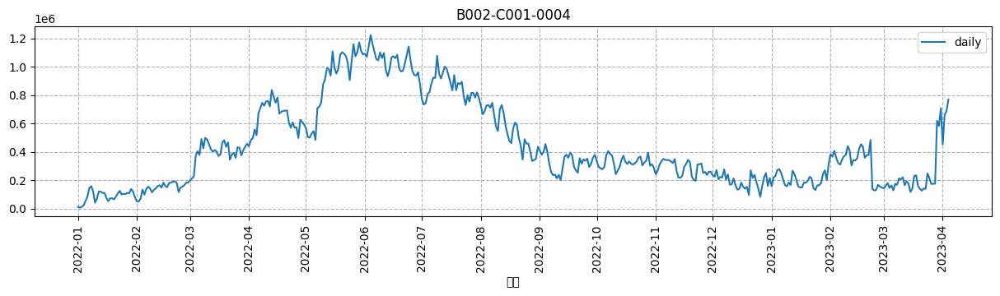

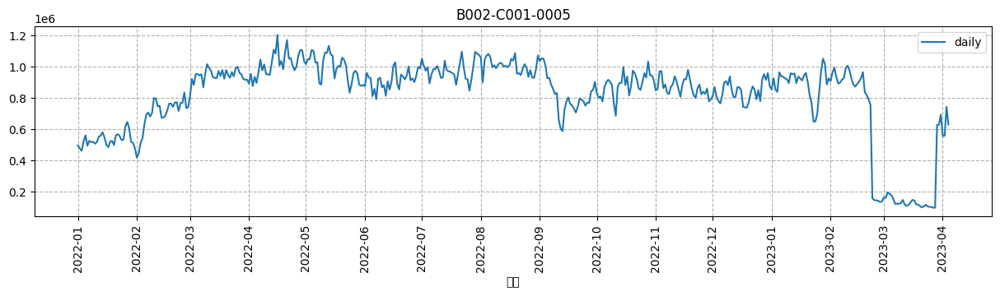

In [ ]:
data_summation = train_df.groupby(['대분류','일자']).sum().reset_index()
plt.figure(figsize=(15,6))
for i,item in enumerate(sorted(original_df['대분류'].unique())):

    data = data_summation[data_summation['대분류']==item]

    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label=item)

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()


for i,item in enumerate(sorted(original_df['대분류'].unique())):
    plt.figure(figsize=(15, 3))

    data = data_summation[data_summation['대분류']==item]

    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
    plt.show()

## ○ 중분류별 시간에따른 판매량 추이

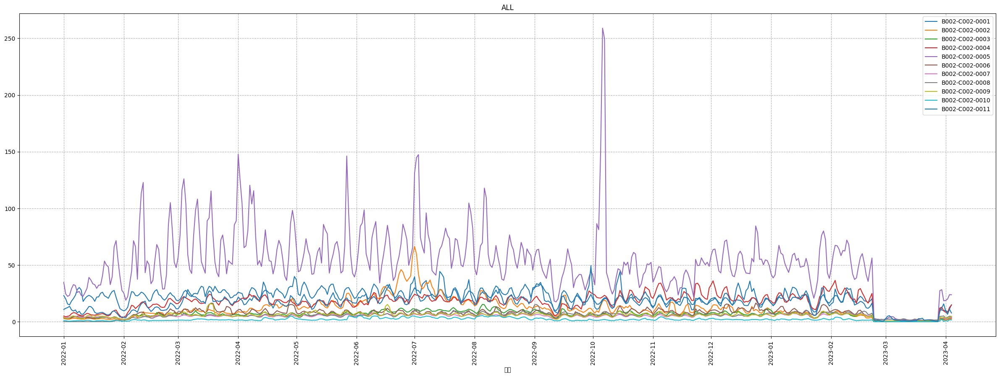

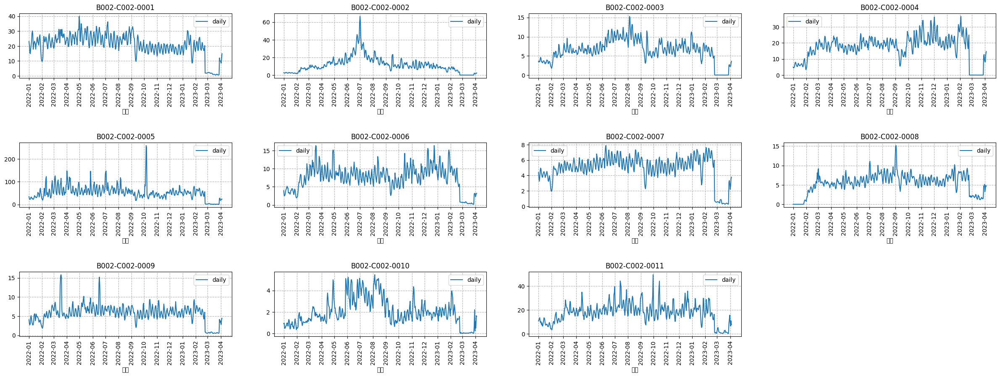

In [ ]:
data_summation = train_df.groupby(['중분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))

for i,item in enumerate(sorted(original_df['중분류'].unique())):
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매량'].values,label=item)


    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['중분류'].unique())):
    plt.subplot(len(original_df['중분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())


    plt.title(f'{item}')
plt.show()

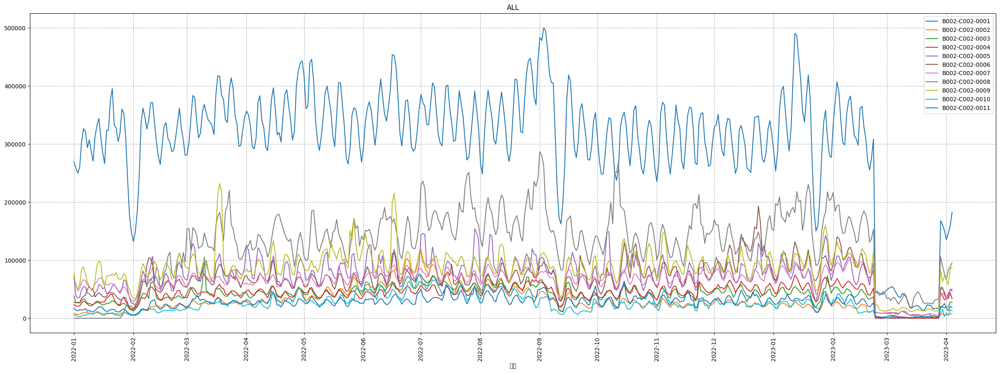

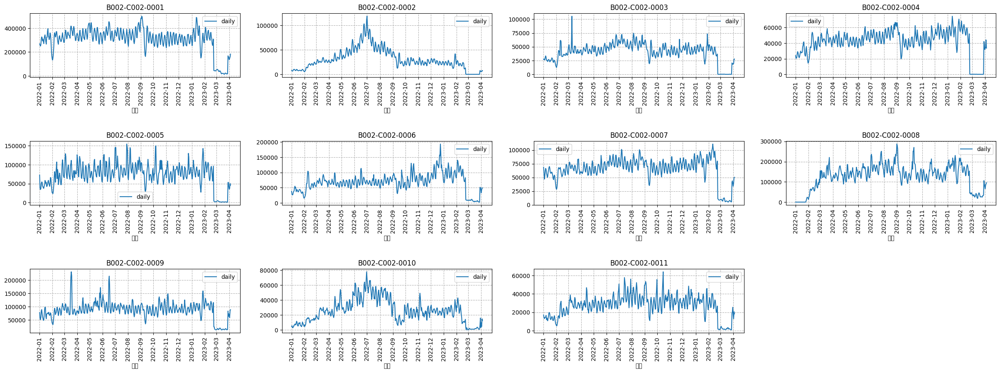

In [ ]:
data_summation = train_df.groupby(['중분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))

for i,item in enumerate(sorted(original_df['중분류'].unique())):
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label=item)


    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['중분류'].unique())):
    plt.subplot(len(original_df['중분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())


    plt.title(f'{item}')
plt.show()

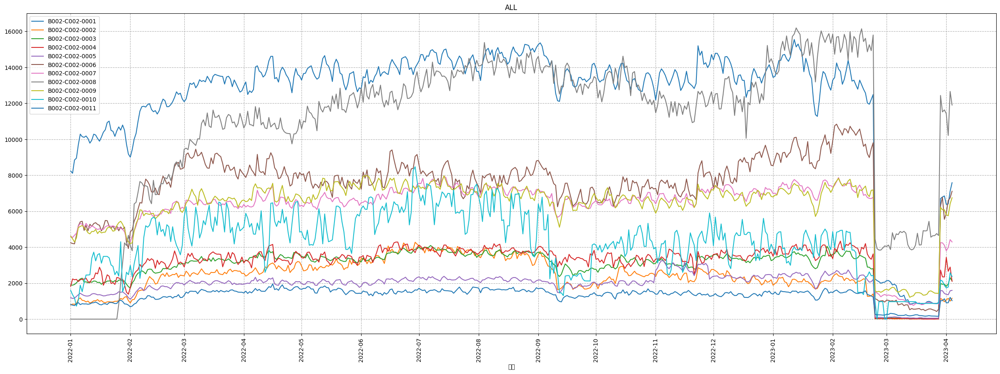

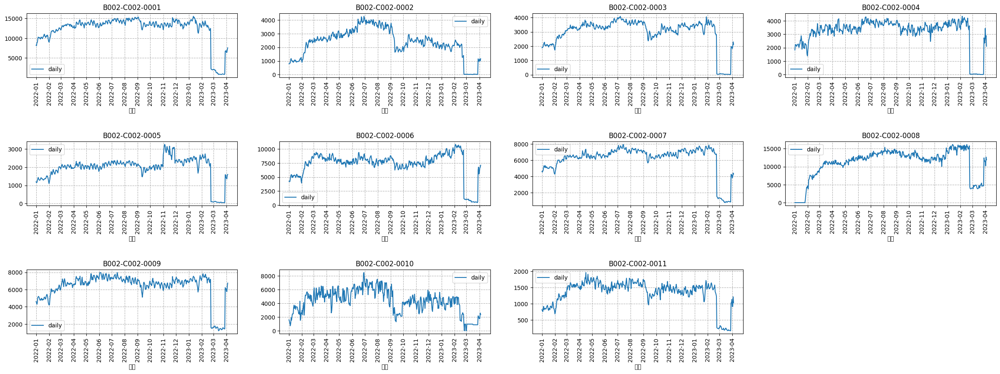

In [ ]:
data_summation = train_df.groupby(['중분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))

for i,item in enumerate(sorted(original_df['중분류'].unique())):
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label=item)


    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'ALL')
plt.show()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['중분류'].unique())):
    plt.subplot(len(original_df['중분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['중분류']==item]

    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())


    plt.title(f'{item}')
plt.show()

## ○ 소분류별 시간에 따른 판매량 추이

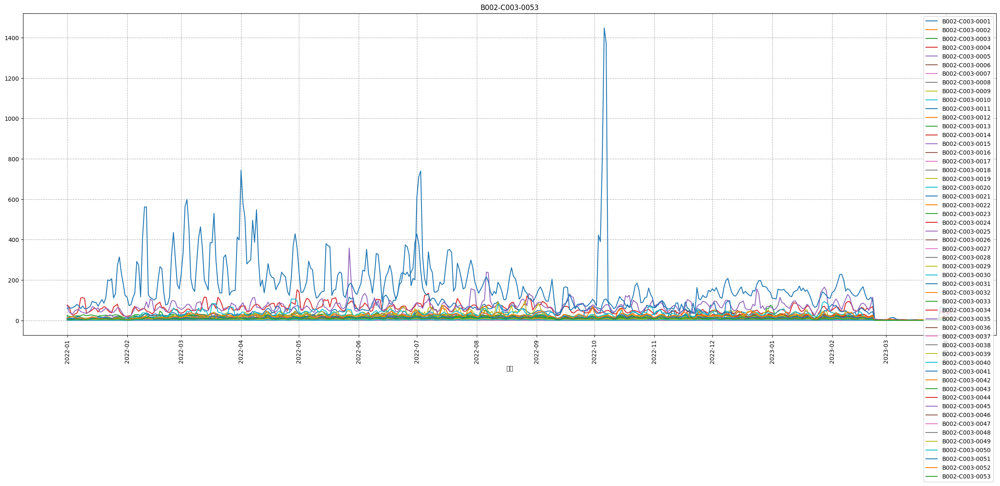

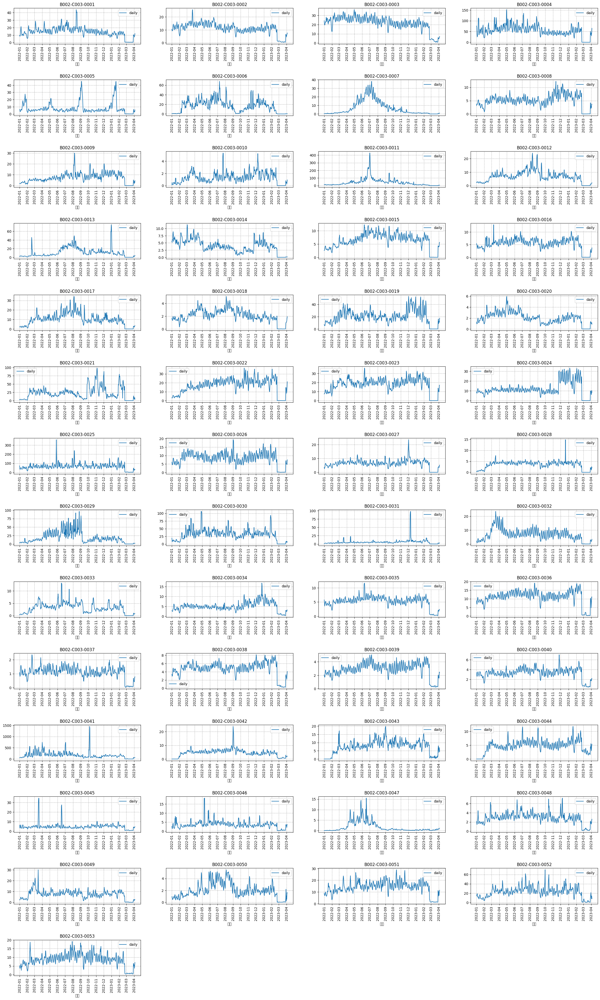

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    data = data_summation[data_summation['소분류']==item]
    sns.lineplot(x=data['일자'], y=data['판매량'].values,label=item)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())


    plt.title(f'{item}')
plt.show()

plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)

    data = data_summation[data_summation['소분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

In [ ]:
data_summation = train_df_with_product_info.dropna().groupby(['소분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    data = data_summation[data_summation['소분류']==item]
    sns.lineplot(x=data['일자'], y=data['판매량'].values,label=item)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    data = data_summation[data_summation['소분류']==item]
    plt.subplots_adjust(hspace=1)



    sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'{item}')
plt.show()

## ○소분류별 시간에 따른 전체판매금액 추이



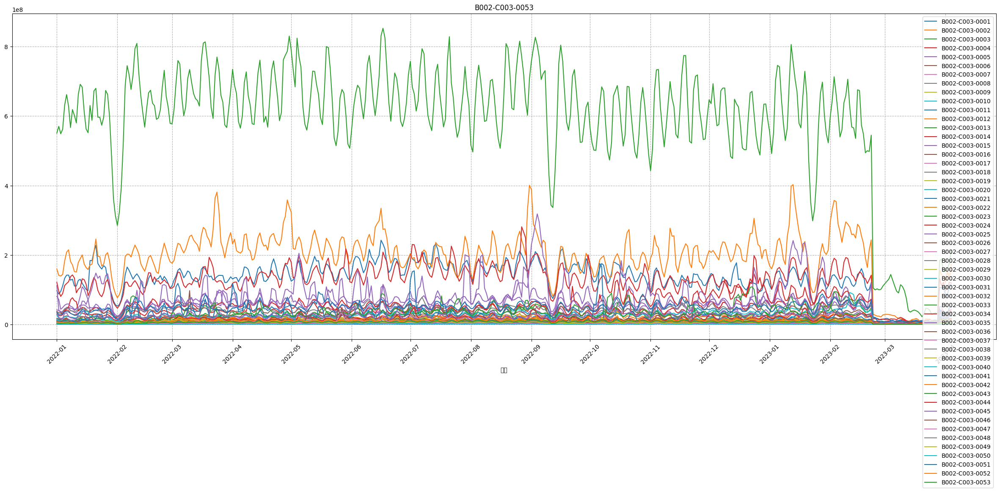

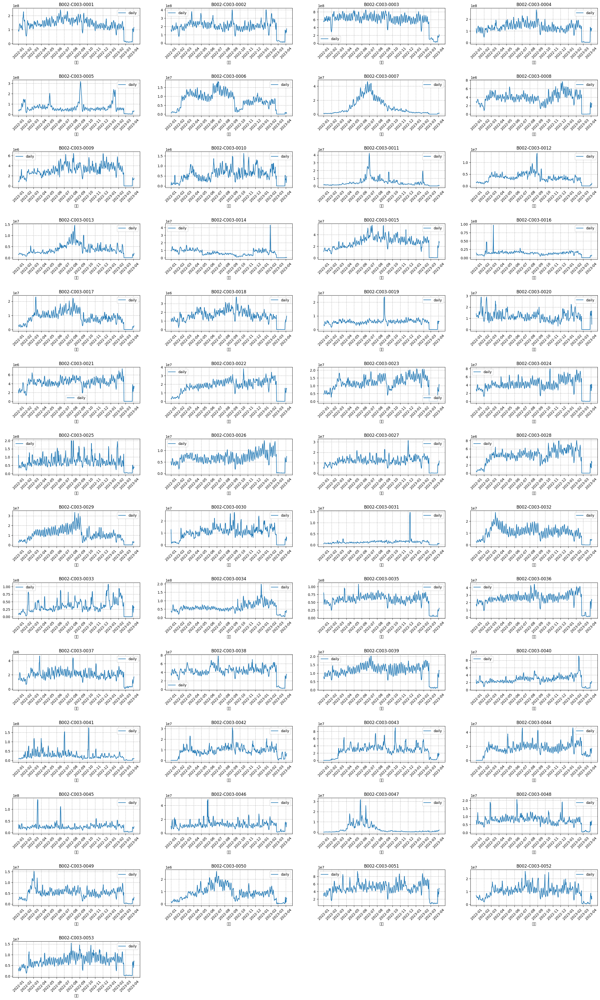

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).sum().reset_index()
plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    data = data_summation[data_summation['소분류']==item]
    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label=item)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())
    plt.title(f'{item}')
plt.show()

plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['소분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

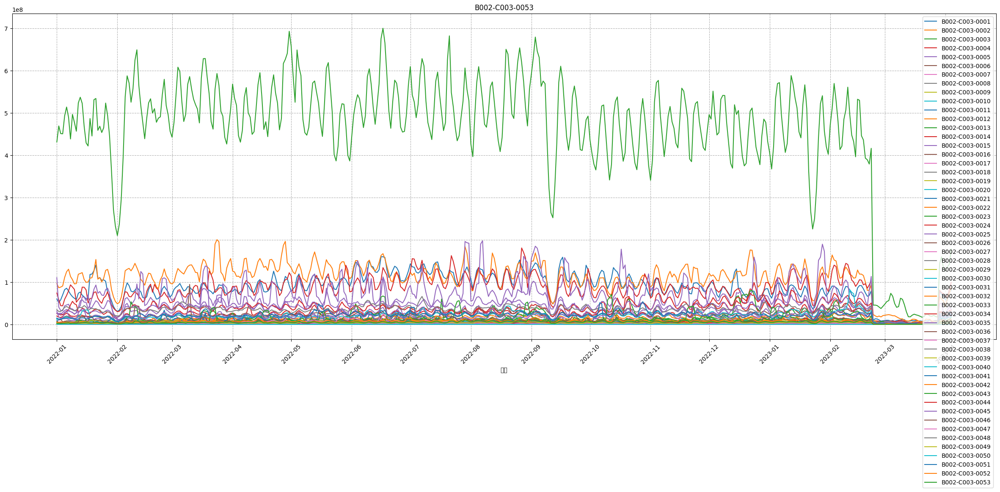

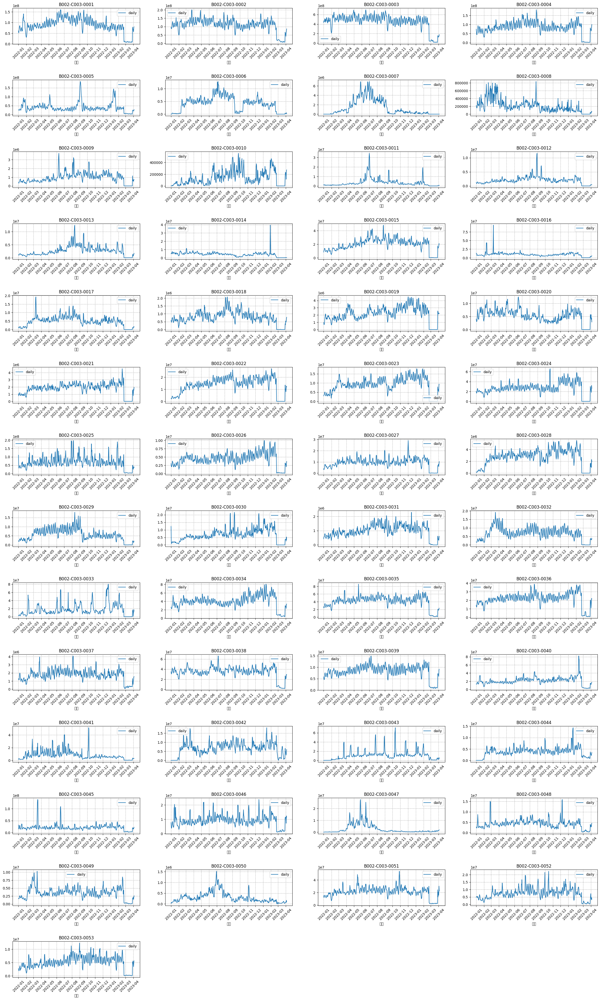

In [ ]:
data_summation = train_df_with_product_info.dropna().groupby(['소분류','일자']).sum().reset_index()
plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    data = data_summation[data_summation['소분류']==item]
    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label=item)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['소분류']==item]

    sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

## ○소분류별 시간에 따른 일별 평균 판매금액

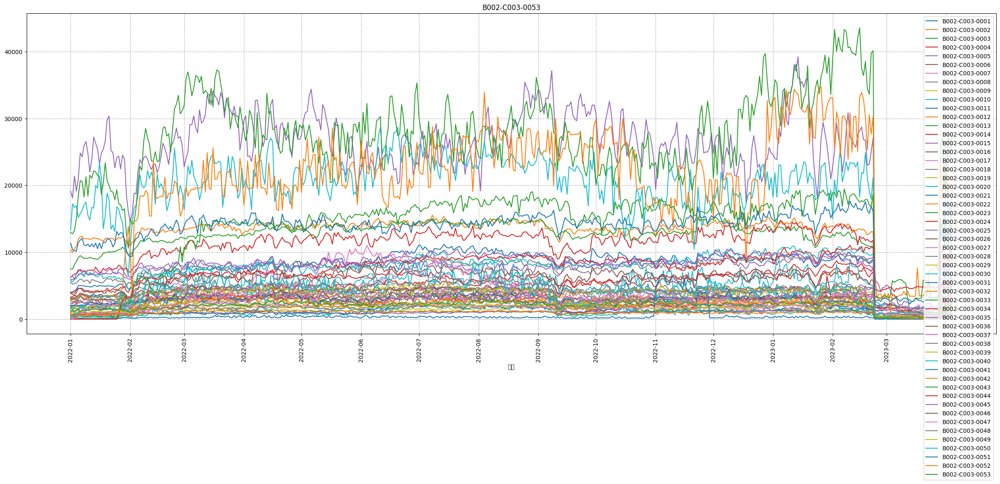

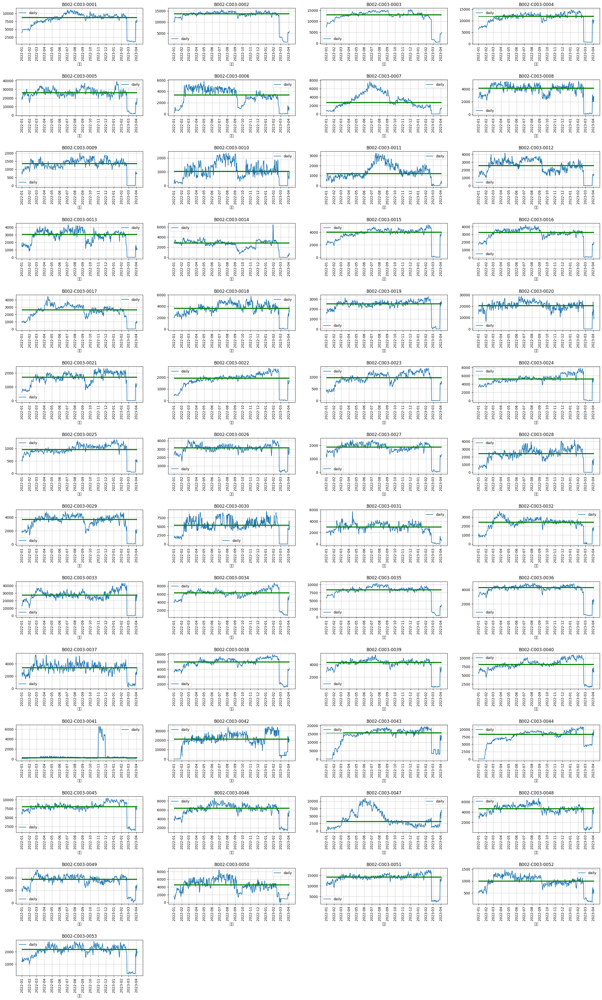

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    data = data_summation[data_summation['소분류']==item]
    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label=item)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['소분류']==item]
    mean_sales_rolling_3d = data.rolling(window=3).mean()
    mean_sales_rolling_7d = data.rolling(window=7).mean()
    mean_sales_rolling_30d = data.rolling(window=30).mean()


    mean_sales = data['평균판매금액'].values
    mean_sales_3d = mean_sales_rolling_3d['평균판매금액'].values
    mean_sales_7d = mean_sales_rolling_7d['평균판매금액'].values
    mean_sales_30d = mean_sales_rolling_30d['평균판매금액'].values

    sns.lineplot(x=data['일자'], y=mean_sales,label='daily')
    #sns.lineplot(x=data['일자'], y=mean_sales_3d,label='3')
    #sns.lineplot(x=data['일자'], y=mean_sales_7d,label='7')
    #sns.lineplot(x=data['일자'], y=mean_sales_30d,label='30')

    plt.hlines(np.median(mean_sales),data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=3)

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
plt.show()

## ○소분류별 가격에 따른 판매량

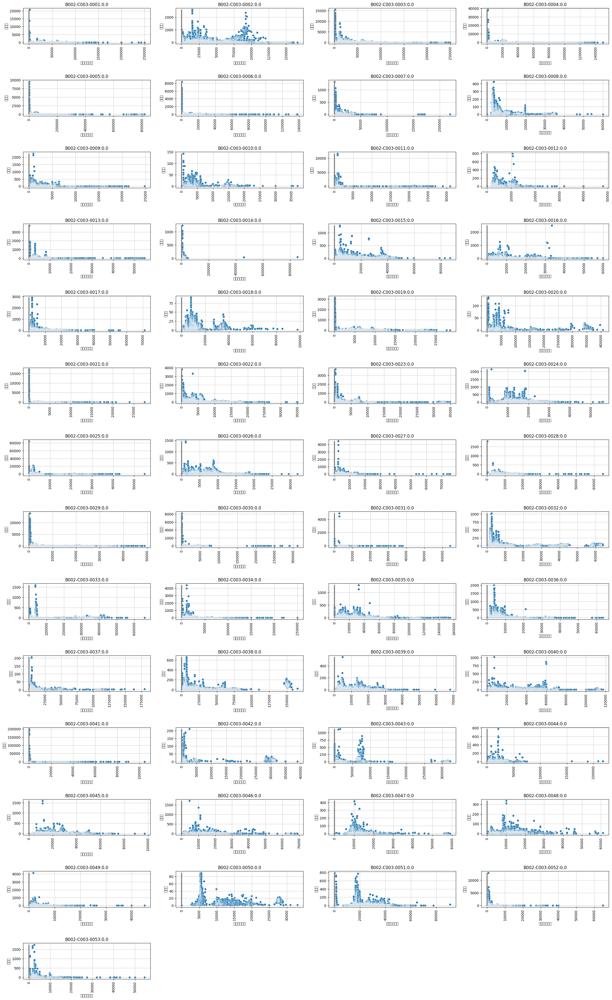

In [ ]:
data_summation = train_df.groupby(['소분류','평균판매금액']).mean().reset_index()
plt.figure(figsize=(30, 50))
for i,item in enumerate(sorted(original_df['소분류'].unique())):
    plt.subplot(len(original_df['소분류'].unique())//4+1,4,i+1)
    plt.subplots_adjust(hspace=1)

    td = train_df[train_df['소분류']==item]
    mean_sales = (td['평균판매금액']).median()

    data = data_summation[data_summation['소분류']==item]


    sns.scatterplot(x=data['평균판매금액'] , y=data['판매량'])
    plt.vlines(mean_sales,0,data['판매량'].max(), color='gray', linestyle='solid', linewidth=3)

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.title(f'{item}:{mean_sales}')
plt.show()

## 상관관계

<Axes: >

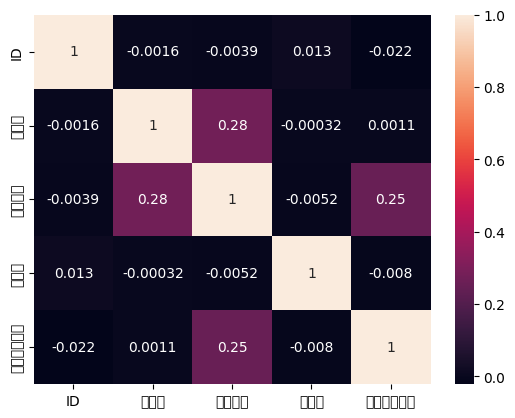

In [ ]:
sns.heatmap(train_df.corr(),annot=True)

## 브랜드별 상관계수 필터링


In [ ]:
train = train_df.copy()
train = train.sort_values(by=['ID','일자'])
brand_keyword_df = brand_keyword_df.sort_values(by=['브랜드','일자'])

In [ ]:
label_encoder = LabelEncoder()
label_encoder.fit(train['브랜드'])
brand_idx = label_encoder.transform(train['브랜드'])

In [ ]:


for i in range(0,train.shape[0],459):
    x = train.iloc[i:i+459]['판매량']
    idx = brand_idx[i]*459
    y = brand_keyword_df.iloc[idx:idx+459]['언급량']

    corr = np.corrcoef(x, y)
    if corr[0][1]>=0.3:
        train.iloc[i:i+459, train.columns.get_loc('언급량')] = y
        print(f'({i//459+1}/{15890}) ID:{i//459} 브랜드:{brand_idx[i]}의 판매량/언급량 상관계수 = {corr[0][1]}')


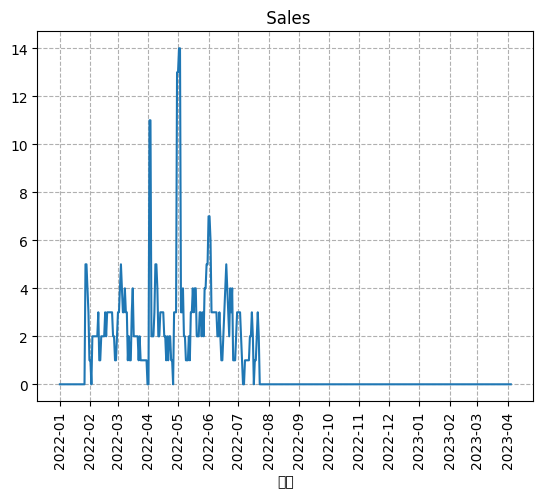

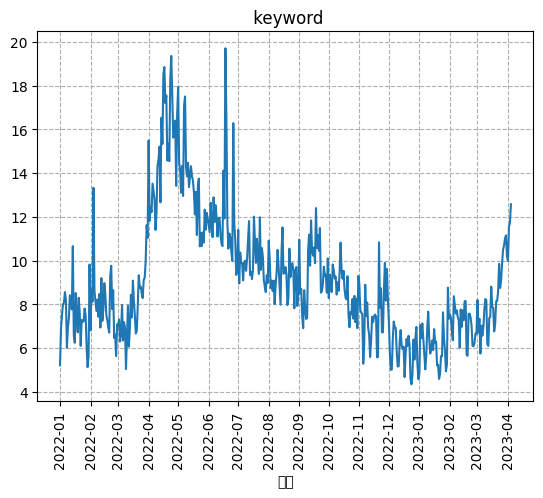

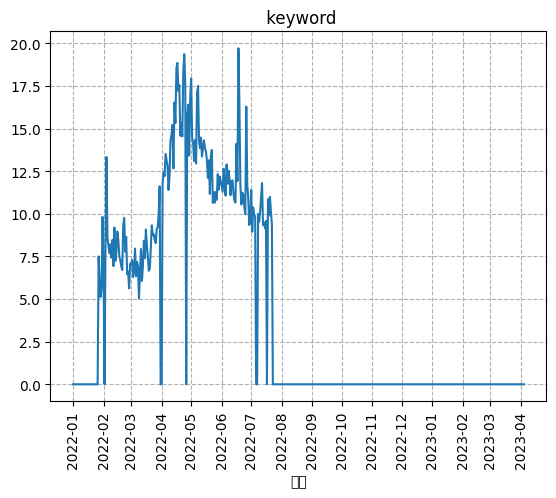

In [ ]:
data = train_df[train_df['ID']==1593]
sns.lineplot(x=data['일자'], y=data['판매량'].values)
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' Sales')

plt.show()

sns.lineplot(x=data['일자'], y=data['언급량'].values)
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' keyword')

plt.show()

sns.lineplot(x=data['일자'], y=data['언급량'].values*(data['판매량']>0).values)
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' keyword')

plt.show()

## 판매금액,판매량 상관계수

In [ ]:
train = train_df.copy()
train = train.sort_values(by=['ID','일자'])


(6/15890) ID : 5 의 판매량 판매 금액 상관계수 = 0.7137870318504176


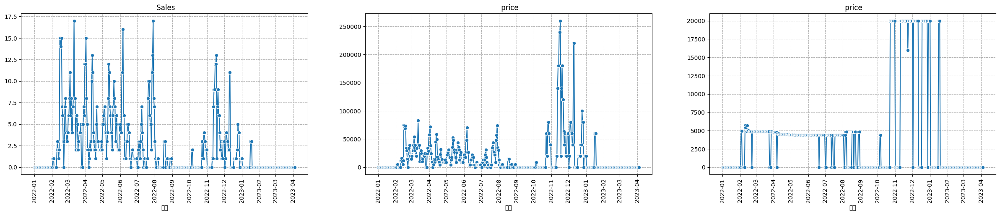

(220/15890) ID : 219 의 판매량 판매 금액 상관계수 = 0.6399870990627019


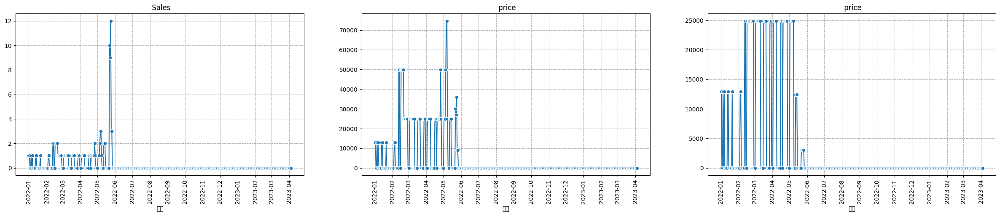

(810/15890) ID : 809 의 판매량 판매 금액 상관계수 = 0.7247775936818539


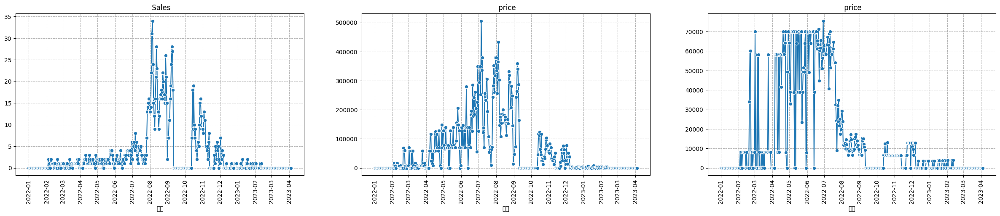

(1102/15890) ID : 1101 의 판매량 판매 금액 상관계수 = 0.7187975145330888


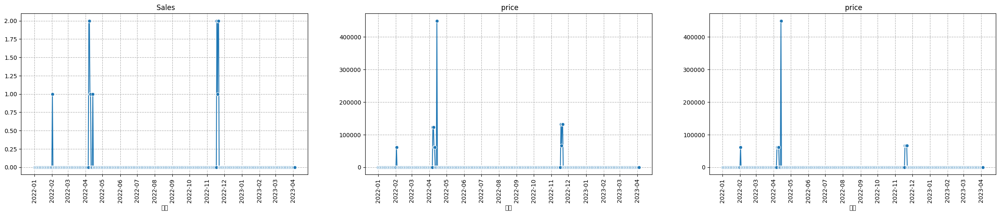

(2061/15890) ID : 2060 의 판매량 판매 금액 상관계수 = 0.36517001628533213


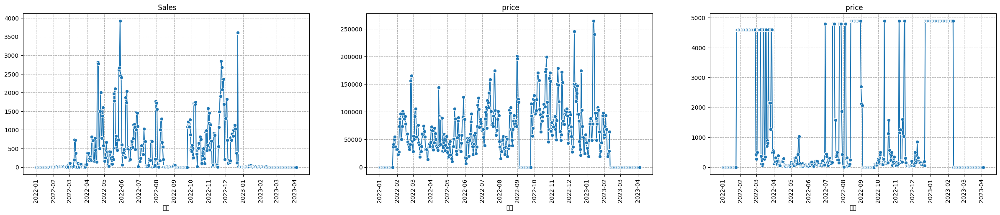

(2329/15890) ID : 2328 의 판매량 판매 금액 상관계수 = 0.7434533157359049


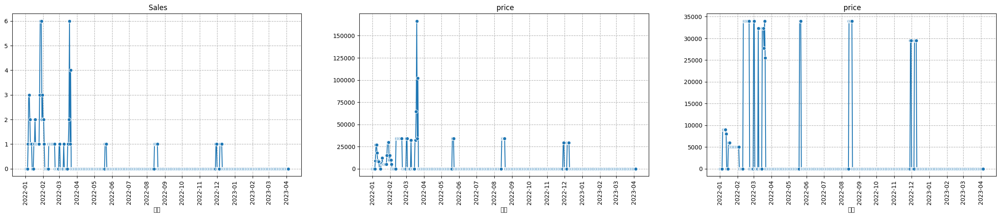

(2495/15890) ID : 2494 의 판매량 판매 금액 상관계수 = 0.5969218064883671


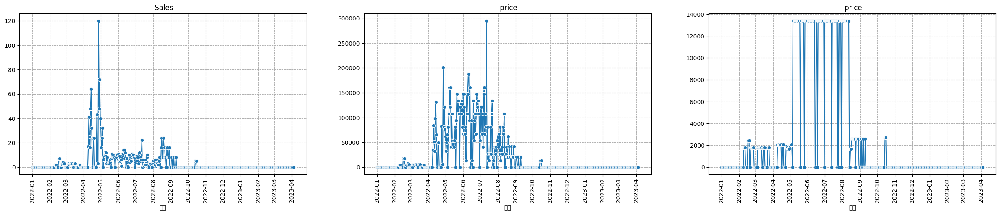

(2812/15890) ID : 2811 의 판매량 판매 금액 상관계수 = 0.7435343888267198


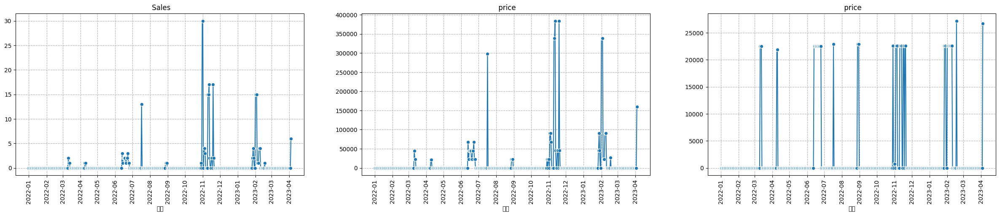

(2838/15890) ID : 2837 의 판매량 판매 금액 상관계수 = 0.7381040996573102


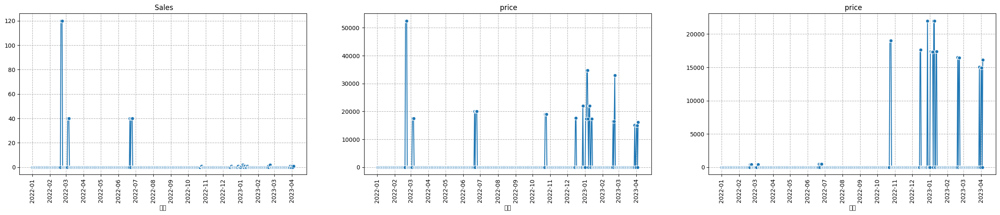

(3618/15890) ID : 3617 의 판매량 판매 금액 상관계수 = 0.3142711752576378


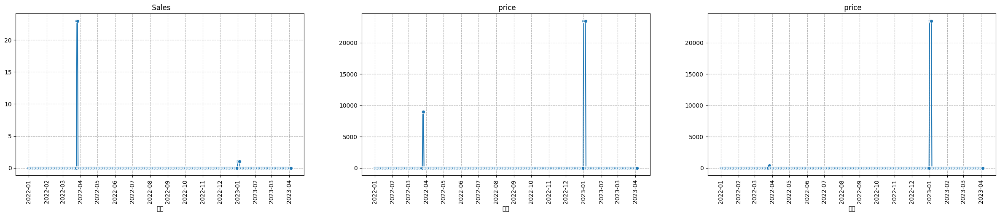

(3821/15890) ID : 3820 의 판매량 판매 금액 상관계수 = 0.5824401026434233


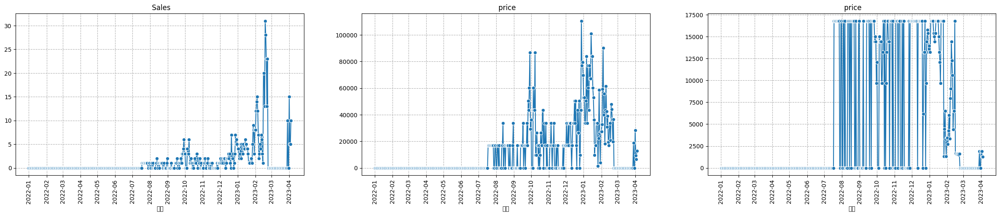

(3996/15890) ID : 3995 의 판매량 판매 금액 상관계수 = 0.3901431198800981


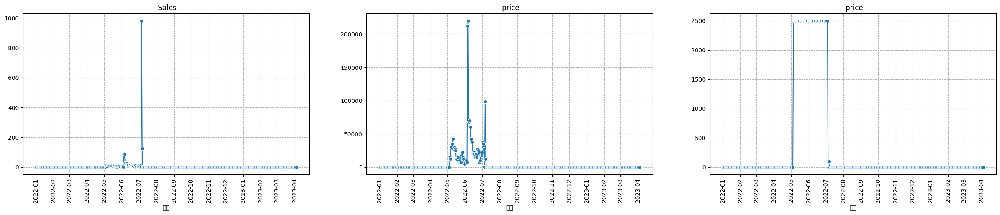

(4385/15890) ID : 4384 의 판매량 판매 금액 상관계수 = 0.7060182707589623


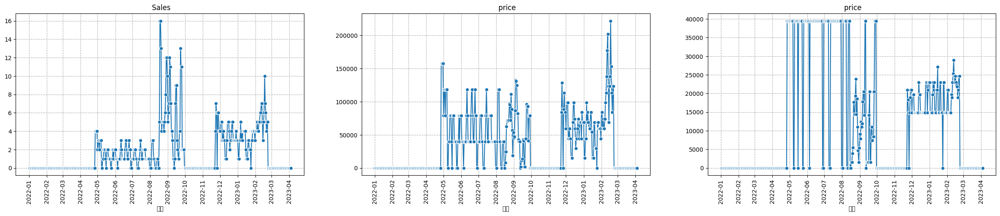

(5633/15890) ID : 5632 의 판매량 판매 금액 상관계수 = 0.1863418054029214


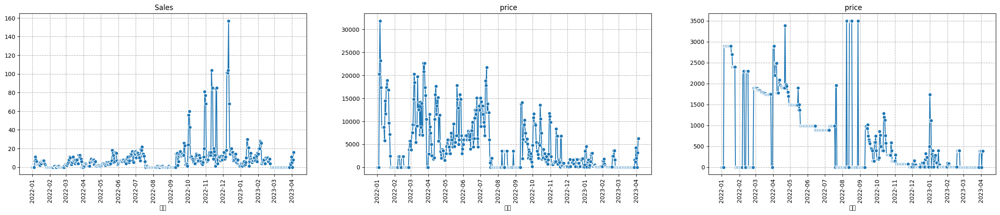

(5952/15890) ID : 5951 의 판매량 판매 금액 상관계수 = 0.6915220621439371


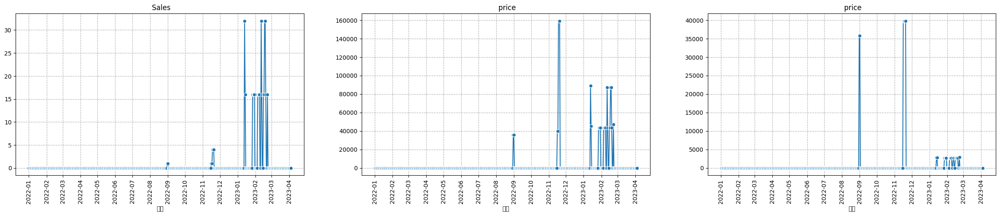

(6860/15890) ID : 6859 의 판매량 판매 금액 상관계수 = 0.40298300683072674


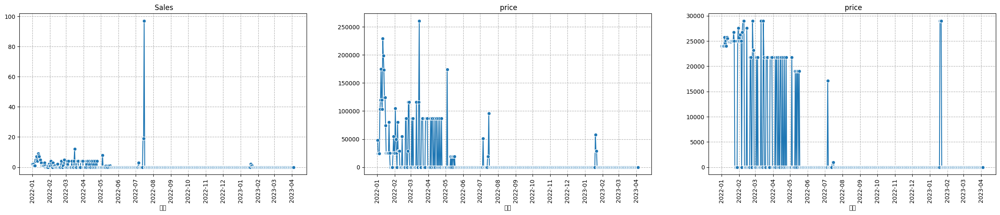

(6992/15890) ID : 6991 의 판매량 판매 금액 상관계수 = 0.7094390579707736


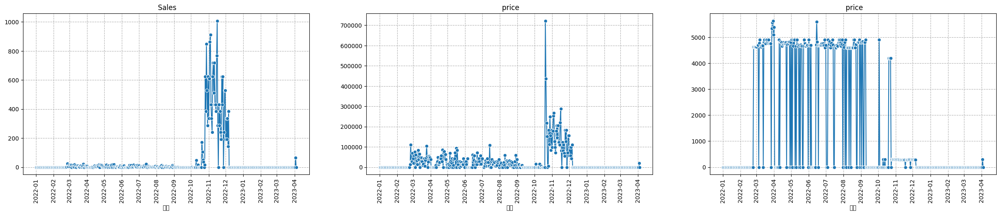

(7145/15890) ID : 7144 의 판매량 판매 금액 상관계수 = 0.6320895236252481


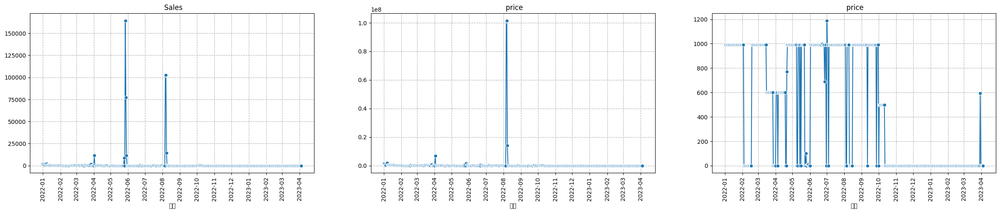

(7440/15890) ID : 7439 의 판매량 판매 금액 상관계수 = 0.420492261153894


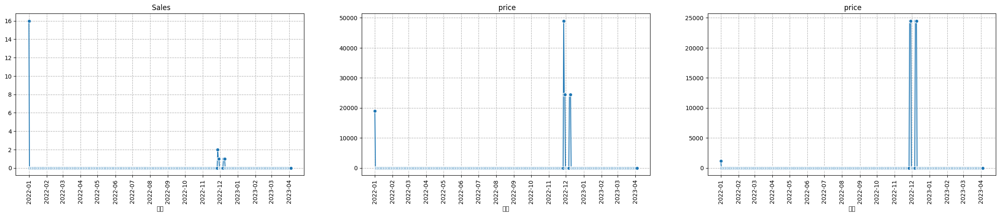

(7710/15890) ID : 7709 의 판매량 판매 금액 상관계수 = 0.7499847498320598


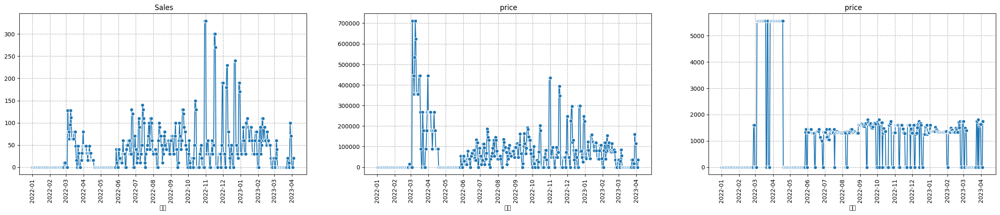

(7832/15890) ID : 7831 의 판매량 판매 금액 상관계수 = 0.6014975672565188


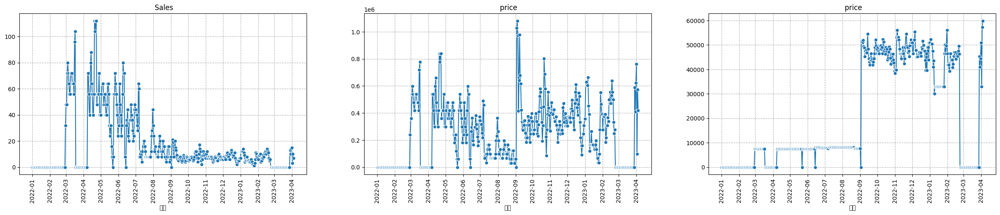

(7852/15890) ID : 7851 의 판매량 판매 금액 상관계수 = 0.6958651526086198


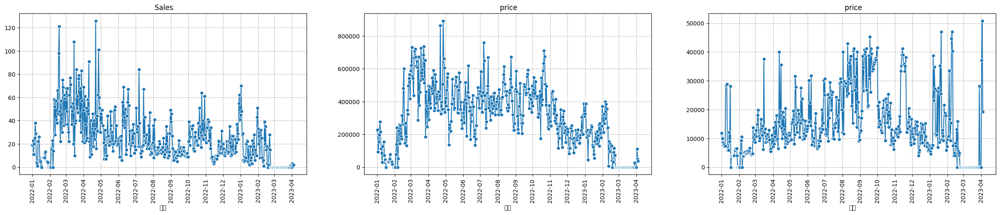

(7881/15890) ID : 7880 의 판매량 판매 금액 상관계수 = 0.7355189422403331


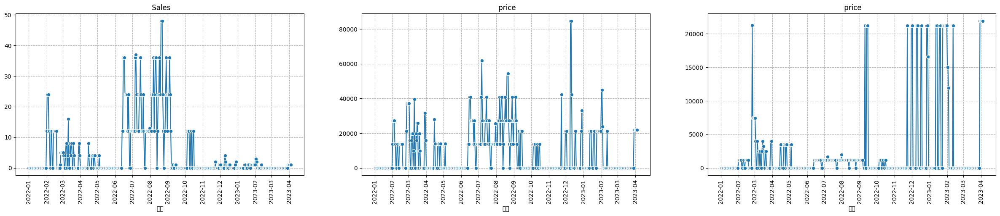

(8044/15890) ID : 8043 의 판매량 판매 금액 상관계수 = 0.7124870887788357


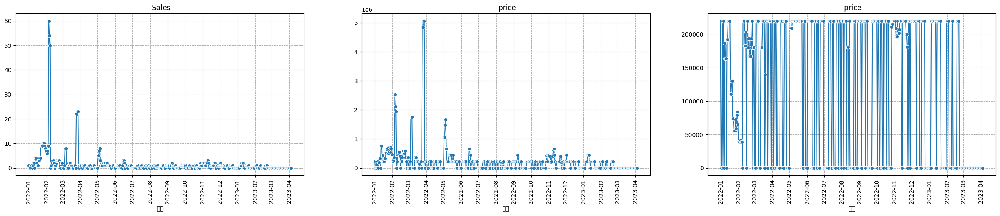

(8211/15890) ID : 8210 의 판매량 판매 금액 상관계수 = 0.5842792504409149


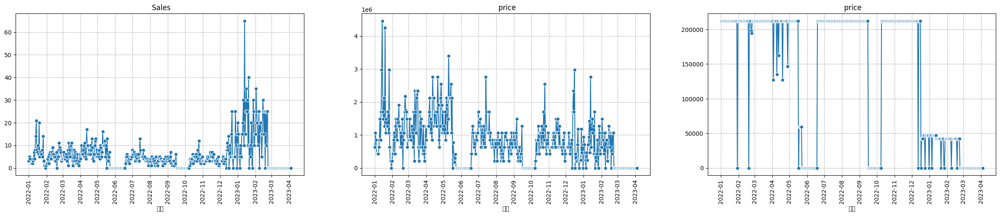

(8544/15890) ID : 8543 의 판매량 판매 금액 상관계수 = 0.7065026489097777


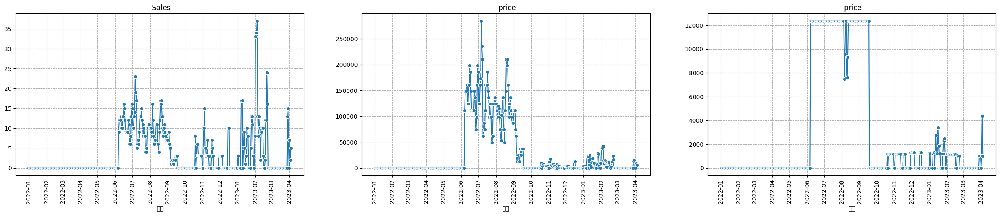

(8713/15890) ID : 8712 의 판매량 판매 금액 상관계수 = 0.4232043207300672


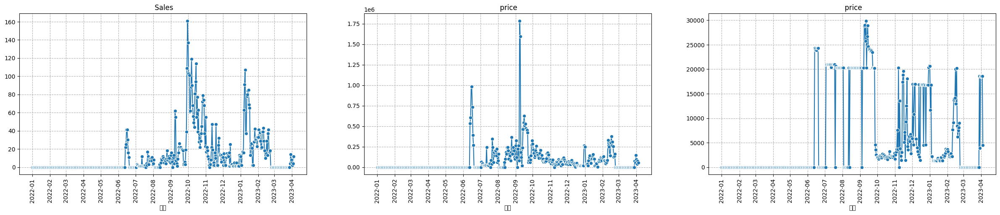

(9399/15890) ID : 9398 의 판매량 판매 금액 상관계수 = 0.09550920229742908


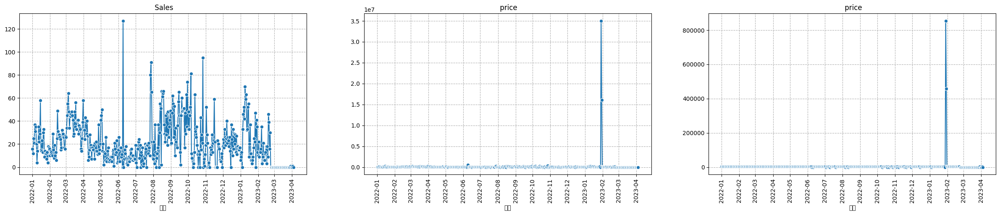

(9643/15890) ID : 9642 의 판매량 판매 금액 상관계수 = 0.5848513907618778


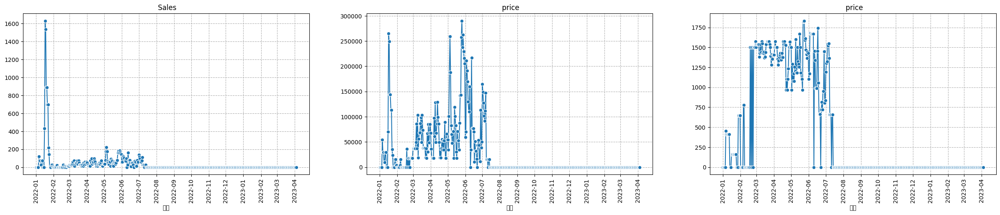

(9674/15890) ID : 9673 의 판매량 판매 금액 상관계수 = 0.4184113289368425


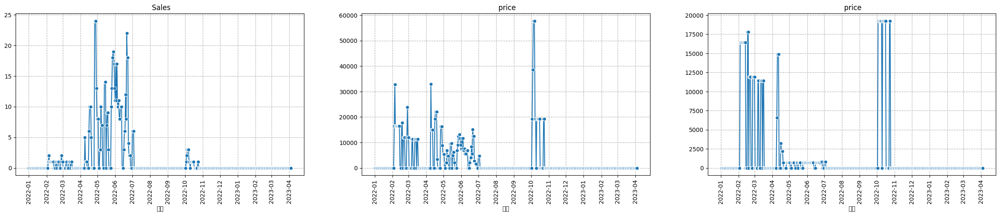

(9694/15890) ID : 9693 의 판매량 판매 금액 상관계수 = 0.5496116766674317


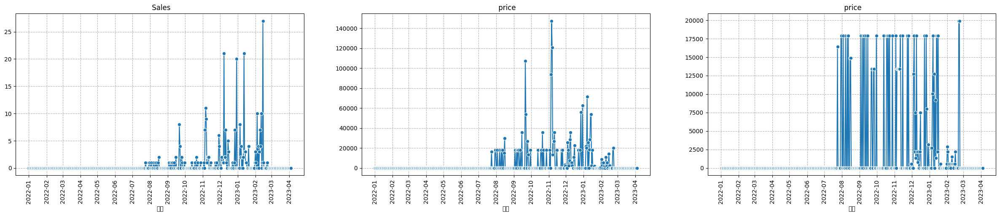

(10278/15890) ID : 10277 의 판매량 판매 금액 상관계수 = 0.1934547943222198


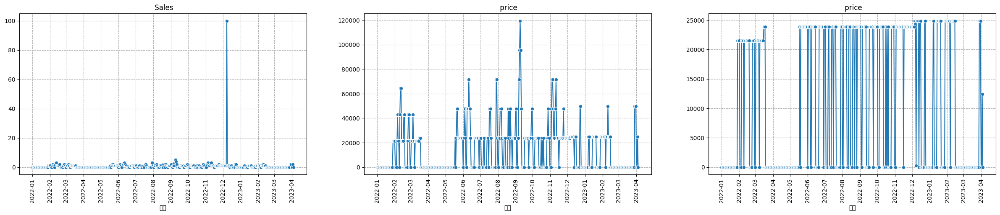

(11626/15890) ID : 11625 의 판매량 판매 금액 상관계수 = 0.6360028242797486


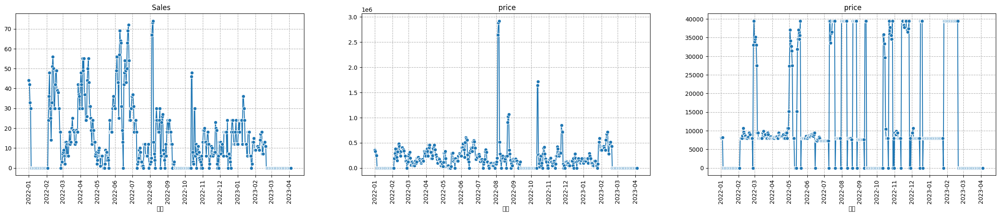

(11682/15890) ID : 11681 의 판매량 판매 금액 상관계수 = 0.6647058057074949


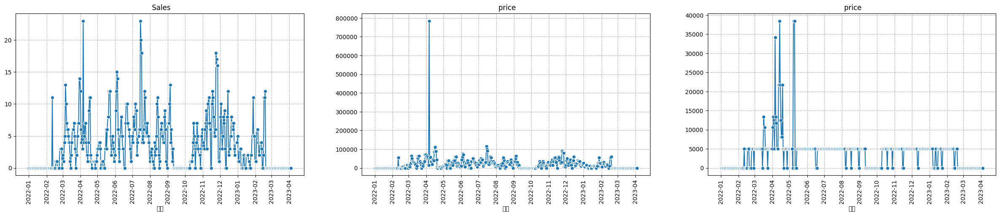

(11767/15890) ID : 11766 의 판매량 판매 금액 상관계수 = 0.6520236223765765


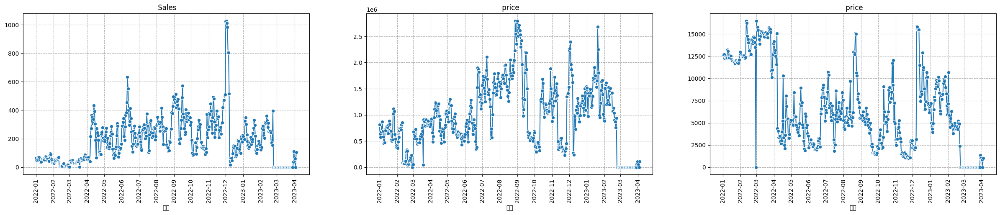

(11898/15890) ID : 11897 의 판매량 판매 금액 상관계수 = 0.5390691023791409


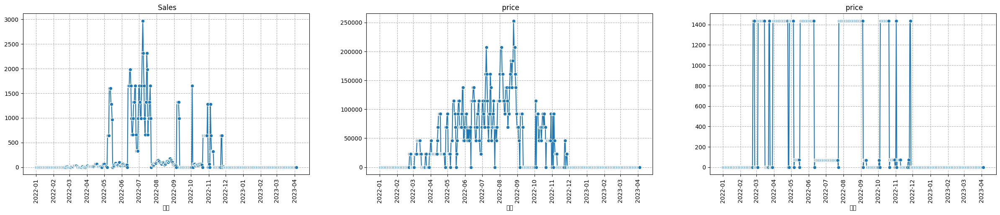

(12245/15890) ID : 12244 의 판매량 판매 금액 상관계수 = 0.7427075528899902


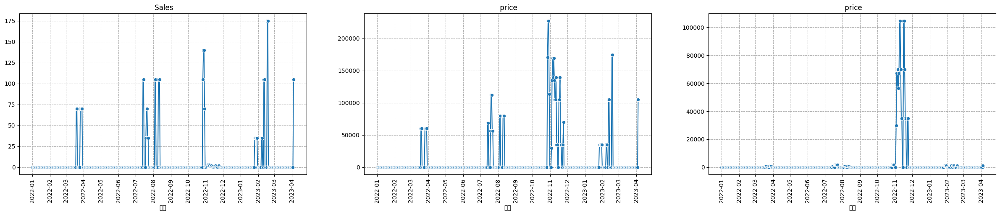

(12296/15890) ID : 12295 의 판매량 판매 금액 상관계수 = 0.5232650204782465


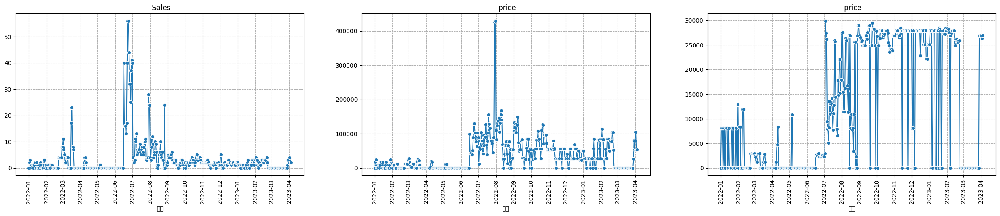

(12301/15890) ID : 12300 의 판매량 판매 금액 상관계수 = 0.4883297156854314


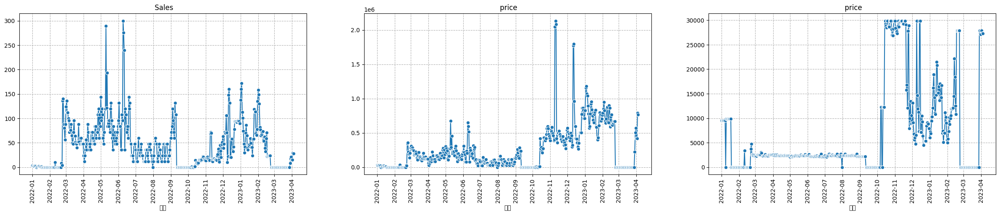

(12872/15890) ID : 12871 의 판매량 판매 금액 상관계수 = 0.3376740850396819


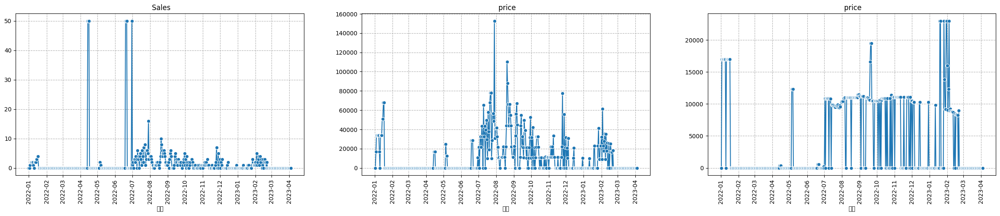

(12933/15890) ID : 12932 의 판매량 판매 금액 상관계수 = 0.6012600575504908


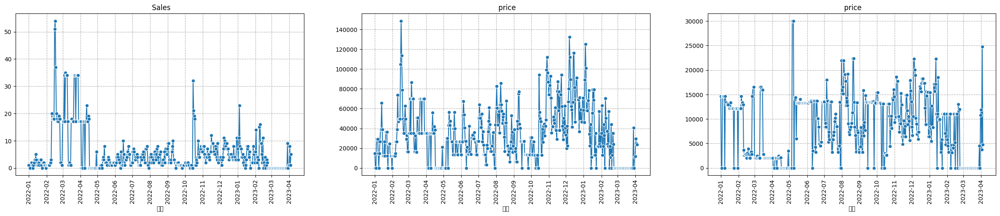

(13299/15890) ID : 13298 의 판매량 판매 금액 상관계수 = 0.6685322978146064


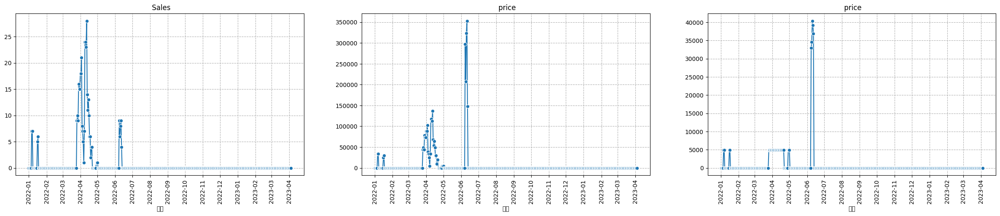

(14554/15890) ID : 14553 의 판매량 판매 금액 상관계수 = 0.63255404623705


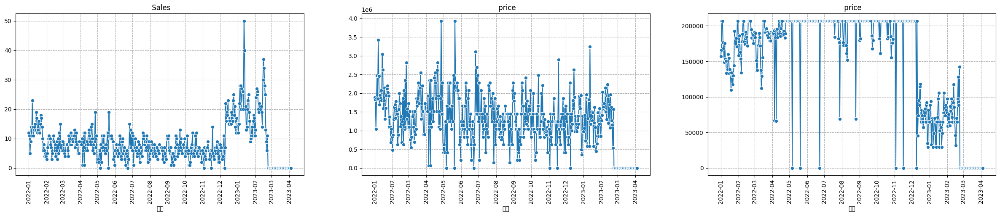

(14859/15890) ID : 14858 의 판매량 판매 금액 상관계수 = 0.717904901262691


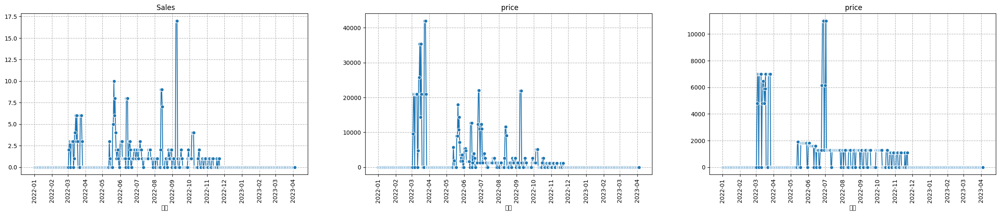

(14958/15890) ID : 14957 의 판매량 판매 금액 상관계수 = 0.7171589574679123


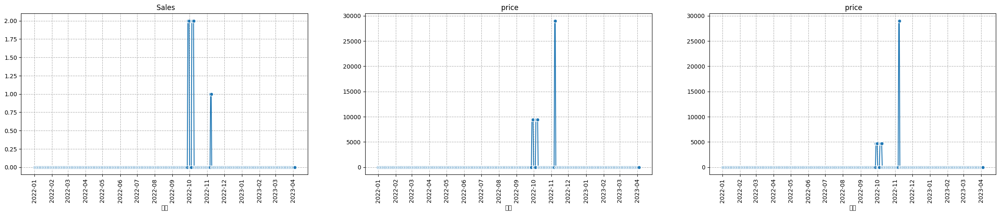

(15167/15890) ID : 15166 의 판매량 판매 금액 상관계수 = 0.7272277495872693


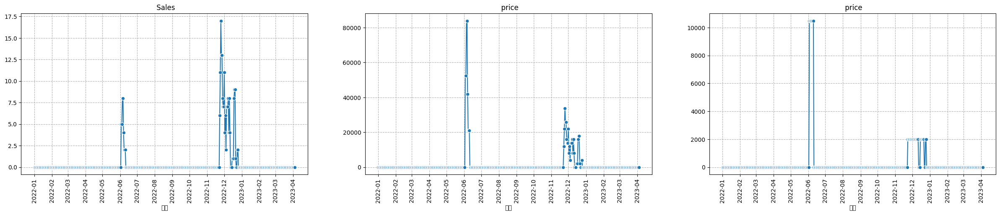

In [ ]:
for i in range(0,train.shape[0],459):
    x = train.iloc[i:i+459]['판매량']
    y =  train.iloc[i:i+459]['판매금액']

    corr = np.corrcoef(x, y)
    if np.abs(corr[0][1])<0.75:
        #train.iloc[i:i+459, train.columns.get_loc('언급량')] = y
        print(f'({i//459+1}/{15890}) ID : {i//459} 의 판매량 판매 금액 상관계수 = {corr[0][1]}')
        data = train_df[train_df['ID']==i//459]

        plt.figure(figsize=(30, 5))
        plt.subplot(1,3,1)
        sns.lineplot(x=data['일자'], y=data['판매량'].values,marker='o')
        plt.grid(True,linestyle='--')
        plt.xticks(rotation=90)
        plt.gca().xaxis.set_major_locator(dates.MonthLocator())

        plt.title(f' Sales')



        plt.subplot(1,3,2)
        sns.lineplot(x=data['일자'], y=data['판매금액'].values,marker='o')
        plt.grid(True,linestyle='--')
        plt.xticks(rotation=90)
        plt.gca().xaxis.set_major_locator(dates.MonthLocator())

        plt.title(f' price')

        plt.subplot(1,3,3)
        sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,marker='o')
        plt.grid(True,linestyle='--')
        plt.xticks(rotation=90)
        plt.gca().xaxis.set_major_locator(dates.MonthLocator())

        plt.title(f' price')

        plt.show()

In [ ]:
data = train_df[train_df['ID']==821]

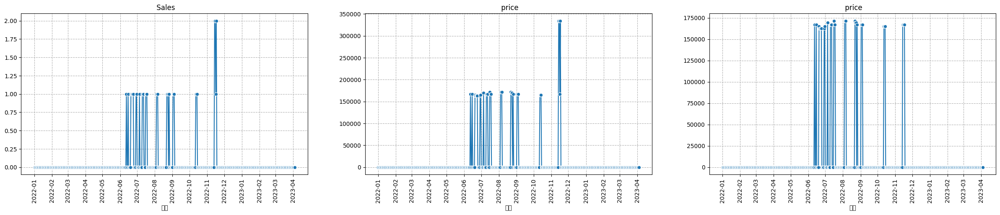

In [ ]:

plt.figure(figsize=(30, 5))
plt.subplot(1,3,1)
sns.lineplot(x=data['일자'], y=data['판매량'].values,marker='o')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' Sales')



plt.subplot(1,3,2)
sns.lineplot(x=data['일자'], y=data['판매금액'].values,marker='o')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' price')

plt.subplot(1,3,3)
sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,marker='o')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f' price')

plt.show()

In [ ]:
data[(data['평균판매금액']>=200000) & (data['평균판매금액']>0)].head(100)

,ID,제품,대분류,중분류,소분류,브랜드,일자,판매량,판매금액,언급량,평균판매금액
2622671,821,B002-00224-00018,B002-C001-0002,B002-C002-0002,B002-C003-0007,B002-00224,2022-06-15,1,220000,5.1494,220000.0


In [ ]:
idx = data['평균판매금액']>= 220000
#idx = (data['평균판매금액']<=15000 )& (data['평균판매금액']>0)
data.loc[idx,'평균판매금액'] = np.median(data[data['평균판매금액']>0]['평균판매금액'].values)
data.loc[idx,'판매금액'] = data.loc[idx,'평균판매금액']*data.loc[idx,'판매량']
#data.loc[idx,'판매량'] = data.loc[idx,'판매금액']/data.loc[idx,'평균판매금액']


In [ ]:
data.loc[idx]

,ID,제품,대분류,중분류,소분류,브랜드,일자,판매량,판매금액,언급량,평균판매금액
2622671,821,B002-00224-00018,B002-C001-0002,B002-C002-0002,B002-C003-0007,B002-00224,2022-06-15,1,167200,5.1494,167200.0


In [ ]:
data

,ID,제품,대분류,중분류,소분류,브랜드,일자,판매량,판매금액,언급량,평균판매금액
9398,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2022-01-01,16,70590,0.08703,4411.875000
25288,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2022-01-02,12,49240,0.11604,4103.333333
41178,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2022-01-03,25,107870,0.10153,4314.800000
57068,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2022-01-04,21,89940,0.13054,4282.857143
72958,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2022-01-05,37,142390,0.08703,3848.378378
...,...,...,...,...,...,...,...,...,...,...,...
7223458,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2023-03-31,0,0,0.15955,0.000000
7239348,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2023-04-01,0,0,0.10153,0.000000
7255238,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2023-04-02,0,0,0.24659,0.000000
7271128,9398,B002-02227-00018,B002-C001-0002,B002-C002-0003,B002-C003-0014,B002-02227,2023-04-03,1,3650,0.13054,3650.000000


## 일별 브랜드 언급량 평균

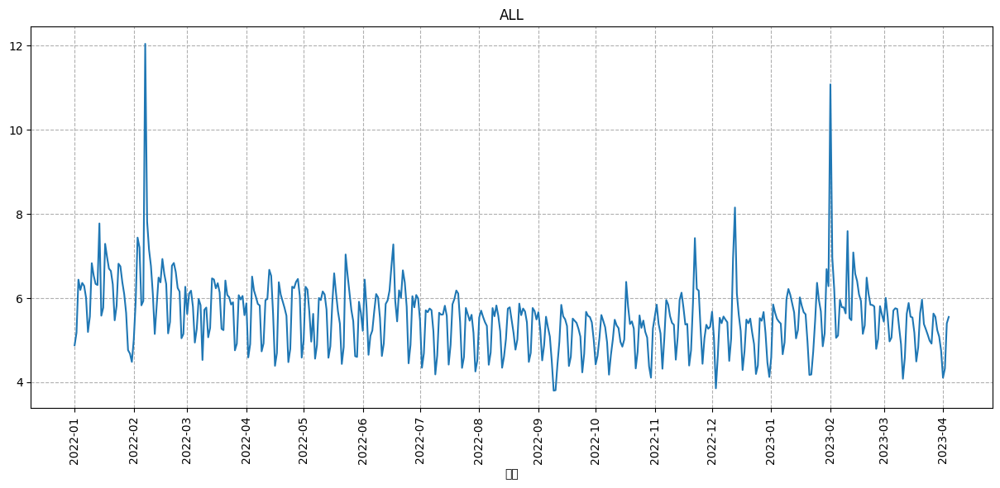

In [ ]:

data_summation = train_df.groupby(['일자']).mean().reset_index()
plt.figure(figsize=(15, 6))

sns.lineplot(x=data_summation['일자'], y=data_summation['언급량'].values,)



plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())
plt.title(f'ALL')
plt.show()

## 소분류별 제품특성 상세확인(단체)

In [ ]:
sub_division = 'B002-C003-0001'

In [ ]:
len(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())

751

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()
mean_price = data_summation[data_summation['소분류']==sub_division]
mean_price = mean_price[mean_price['판매금액']>0]
mean_price = mean_price['평균판매금액'].mean()
print(mean_price)

7961.400990801629


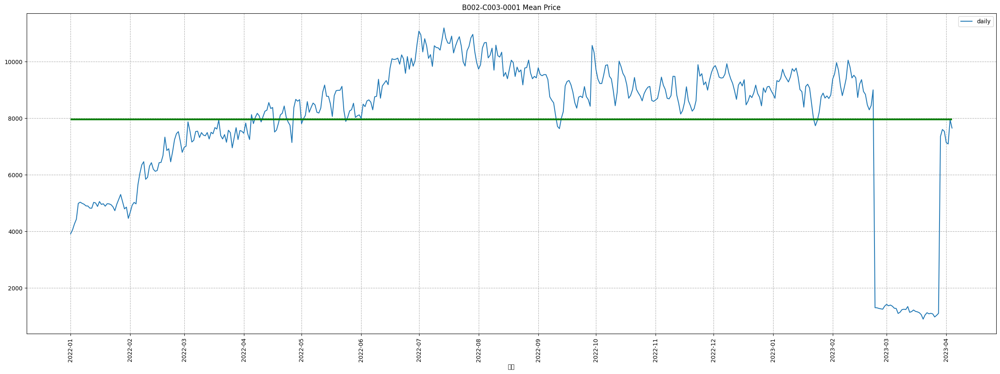

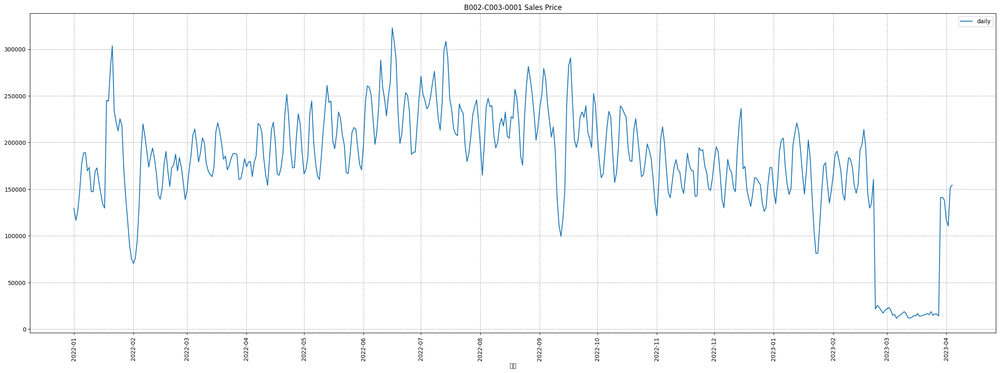

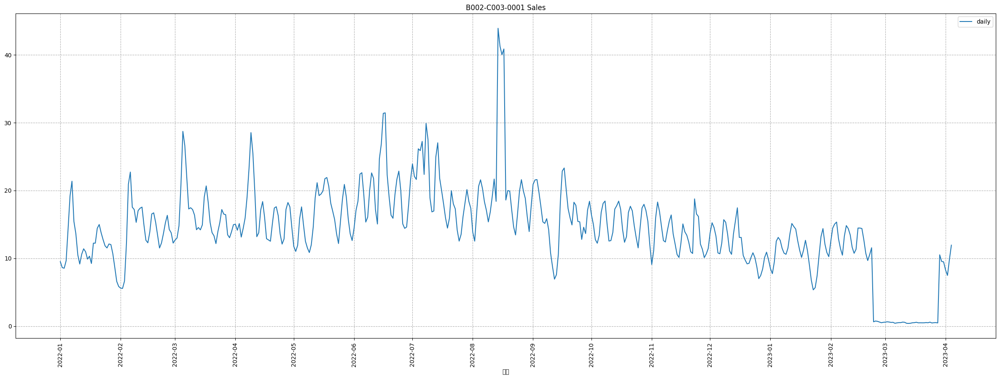

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))
plt.subplots_adjust(hspace=1)
data = data_summation[data_summation['소분류']==sub_division]

sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.hlines(mean_price,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=3)


plt.title(f'{sub_division} Mean Price')
plt.show()

plt.figure(figsize=(30, 10))
sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())


plt.title(f'{sub_division} Sales Price')
plt.show()


plt.figure(figsize=(30, 10))
sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())


plt.title(f'{sub_division} Sales')
plt.show()

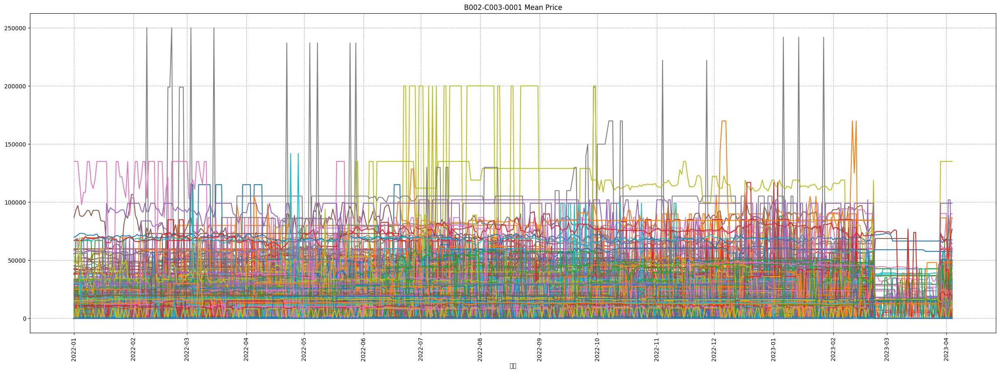

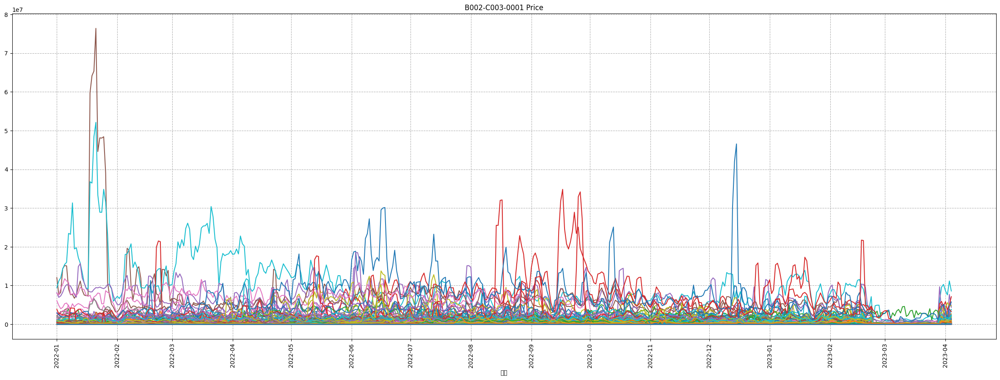

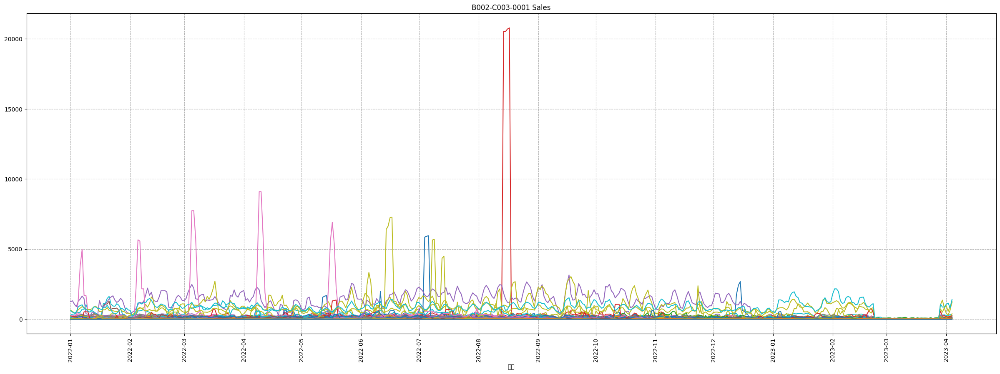

In [ ]:
data_summation = train_df.groupby(['소분류','ID','일자']).mean().reset_index()
data_summation = data_summation[data_summation['소분류']==sub_division]


plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = data_summation[data_summation['ID']==item]
    sns.lineplot(x=data['일자'], y=data['평균판매금액'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Mean Price')


plt.show()



plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = data_summation[data_summation['ID']==item]
    sns.lineplot(x=data['일자'], y=data['판매금액'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Price')

plt.show()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = data_summation[data_summation['ID']==item]
    sns.lineplot(x=data['일자'], y=data['판매량'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Sales')

plt.show()

In [ ]:
data_summation[data_summation['판매량']>3000]

,소분류,ID,일자,판매량,판매금액,언급량,평균판매금액
142474,B002-C003-0001,6803,2022-07-04,5852.0,10802900.0,0.000000,1846.018455
142475,B002-C003-0001,6803,2022-07-05,5911.0,10911500.0,0.000000,1845.965150
142476,B002-C003-0001,6803,2022-07-06,5954.0,10990800.0,0.000000,1845.952301
143892,B002-C003-0001,6806,2022-08-14,20520.0,25547400.0,0.000000,1245.000000
143893,B002-C003-0001,6806,2022-08-15,20520.0,25547400.0,0.000000,1245.000000
143894,B002-C003-0001,6806,2022-08-16,20700.0,31981500.0,0.000000,1545.000000
143895,B002-C003-0001,6806,2022-08-17,20780.0,32105100.0,0.000000,1545.000000
158155,B002-C003-0001,7161,2022-09-17,3148.0,2691630.0,0.971850,855.028590
159992,B002-C003-0001,7169,2022-09-18,3036.0,1844030.0,1.044380,607.388011
178247,B002-C003-0001,7683,2022-06-05,3333.0,2877200.0,2.045236,863.246325


In [ ]:
rolling = data_summation.rolling(11,  center=True).mean()

In [ ]:
test = data_summation.copy()

In [ ]:
idx =  test.loc[test['판매량']>3000].index

test.loc[idx,'판매량'] = rolling.loc[idx,'판매량']
test.loc[idx,'판매금액'] = rolling.loc[idx,'판매량'].values * test.loc[idx,'평균판매금액'].values
#test.loc[test['판매량']>3000,['판매량','판매금액']] = rolling.loc[test['판매량']>3000,'판매량']
#test.loc[test['판매량']>3000,'판매금액'] = rolling.loc[test['판매량']>3000,'판매량'] * rolling.loc[test['판매량']>3000,'평균판매금액']

In [ ]:
test.loc[idx]

,소분류,ID,일자,판매량,판매금액,언급량,평균판매금액
142474,B002-C003-0001,6803,2022-07-04,1685.636364,3.111716e+06,0.000000,1846.018455
142475,B002-C003-0001,6803,2022-07-05,1691.272727,3.122031e+06,0.000000,1845.965150
142476,B002-C003-0001,6803,2022-07-06,1692.000000,3.123351e+06,0.000000,1845.952301
143892,B002-C003-0001,6806,2022-08-14,7608.181818,9.472186e+06,0.000000,1245.000000
143893,B002-C003-0001,6806,2022-08-15,7617.272727,9.483505e+06,0.000000,1245.000000
143894,B002-C003-0001,6806,2022-08-16,7625.454545,1.178133e+07,0.000000,1545.000000
143895,B002-C003-0001,6806,2022-08-17,7624.545455,1.177992e+07,0.000000,1545.000000
158155,B002-C003-0001,7161,2022-09-17,1625.545455,1.389888e+06,0.971850,855.028590
159992,B002-C003-0001,7169,2022-09-18,1770.090909,1.075132e+06,1.044380,607.388011
178247,B002-C003-0001,7683,2022-06-05,1003.545455,8.663069e+05,2.045236,863.246325


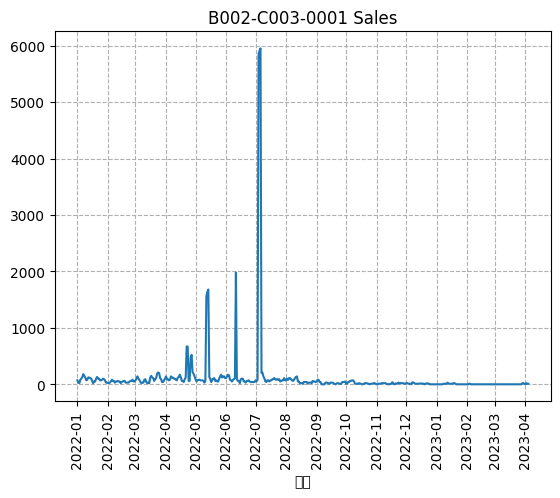

In [ ]:
data = train_df[train_df['ID']==6803]
sns.lineplot(x=data['일자'], y=data['판매량'].values)
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.title(f'{sub_division} Sales')

plt.show()

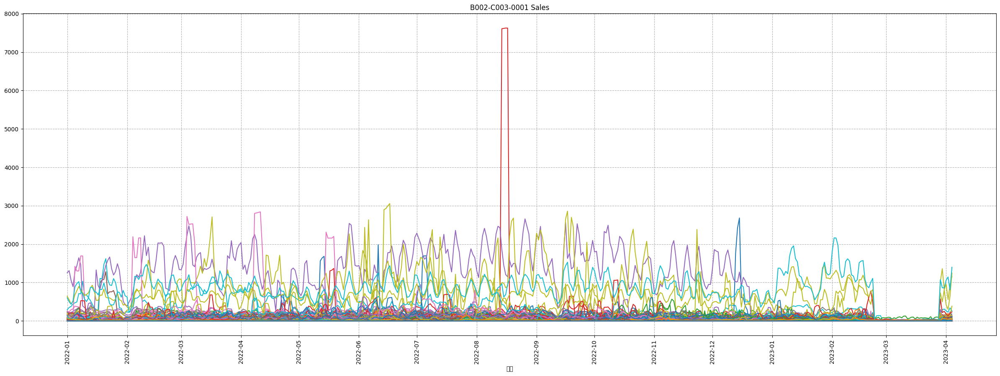

In [ ]:


plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = test[test['ID']==item]
    sns.lineplot(x=data['일자'], y=data['판매량'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Sales')

plt.show()

In [ ]:
data_summation = train_df[train_df['소분류']==sub_division].groupby(['소분류','ID','일자']).mean().reset_index()
rows = len(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())//4+1
plt.figure(figsize=(30, 8*min(rows,25)))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    plt.subplot(min(rows,25),4,i%100+1)
    plt.subplots_adjust(hspace=1)
    data = data_summation[data_summation['ID']==item]


    sns.lineplot(x=data['일자'], y=data['판매량'].values)

    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    #plt.hlines(mean_price,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=3)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{item}')
    if ((i+1)%100 == 0):
        plt.show()
        rows -= 25
        plt.figure(figsize=(30, 8*min(rows,25)))
plt.show()


In [ ]:
product_num = 5515
original_df_with_product_info[original_df_with_product_info['ID']==product_num].head()

In [ ]:
original_df_with_product_info[original_df_with_product_info['ID']==product_num]['제품특성'].values

In [ ]:
original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['제품특성'].unique()

In [ ]:
original_df_with_product_info[original_df_with_product_info['제품특성']=='형태:액상형 구성:본품 등급:1종 용도:식기 용도:과일 용도:야채 용도:조리기구 용량:4000ml :1개 4L']

In [ ]:
data_summation = train_df.groupby(['ID','소분류','브랜드','일자']).sum().reset_index()

In [ ]:

mean_price = data_summation[(data_summation['소분류']==sub_division) * ( data_summation['브랜드']==original_df[original_df['ID']==product_num]['브랜드'].values[0] )]
print(mean_price['ID'].unique())
print("소분류 내에 해당 제품과 동일한 브랜드 개수 : ",mean_price['ID'].nunique())
mean_price = mean_price[mean_price['판매금액']>0]
mean_price = (mean_price['평균판매금액'].values)
print("소분류 내에 해당 제품과 동일한 브랜드의 평균 판매 가격" ,mean_price.mean())

[4062]
소분류 내에 해당 제품과 동일한 브랜드 개수 :  1
소분류 내에 해당 제품과 동일한 브랜드의 평균 판매 가격 17099.447387452125


## 이상치 분석

In [ ]:
sub_division = 'B002-C003-0001'

In [ ]:
len(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())

751

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()
mean_price = data_summation[data_summation['소분류']==sub_division]
mean_price = mean_price[mean_price['판매금액']>0]
mean_price = mean_price['평균판매금액'].mean()
print(mean_price)

7961.400990801629


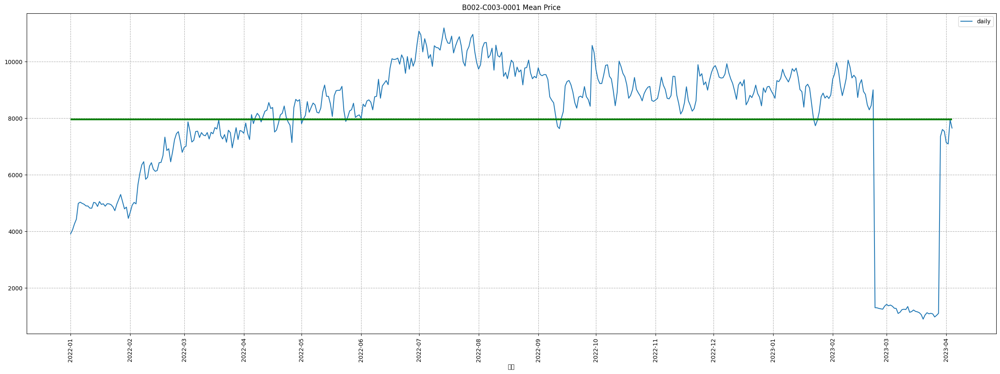

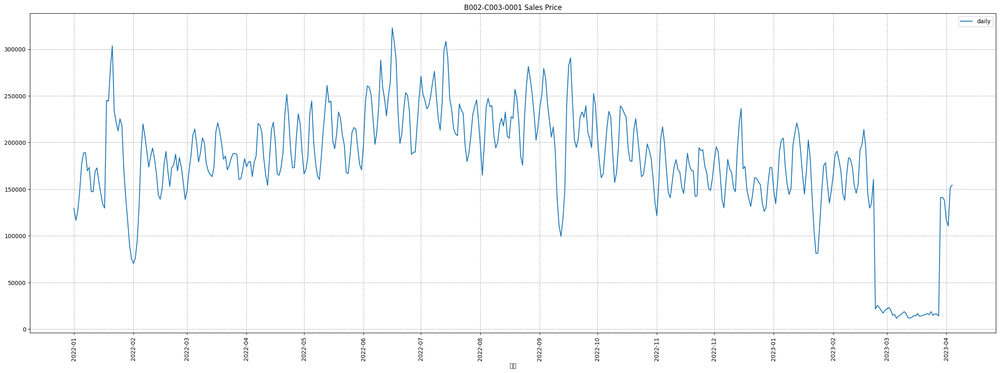

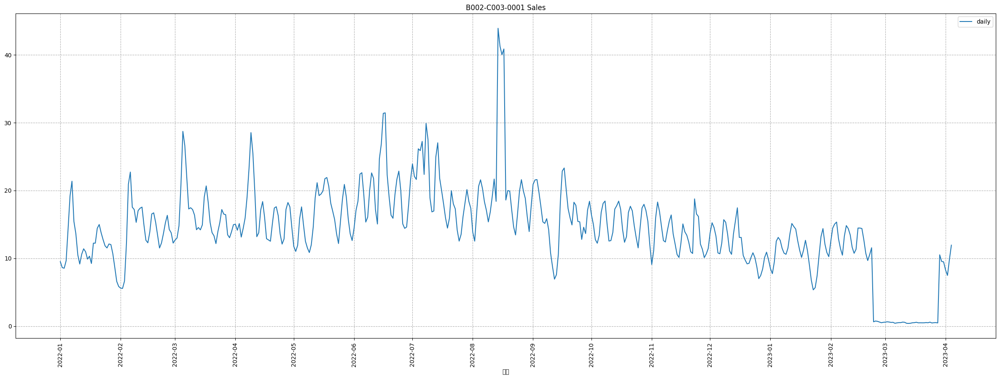

In [ ]:
data_summation = train_df.groupby(['소분류','일자']).mean().reset_index()
plt.figure(figsize=(30, 10))
plt.subplots_adjust(hspace=1)
data = data_summation[data_summation['소분류']==sub_division]

sns.lineplot(x=data['일자'], y=data['평균판매금액'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())

plt.hlines(mean_price,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=3)


plt.title(f'{sub_division} Mean Price')
plt.show()

plt.figure(figsize=(30, 10))
sns.lineplot(x=data['일자'], y=data['판매금액'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())


plt.title(f'{sub_division} Sales Price')
plt.show()


plt.figure(figsize=(30, 10))
sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())


plt.title(f'{sub_division} Sales')
plt.show()

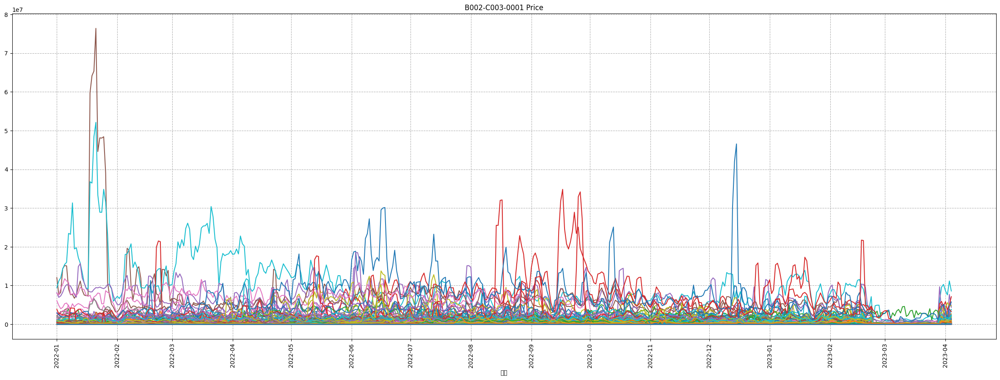

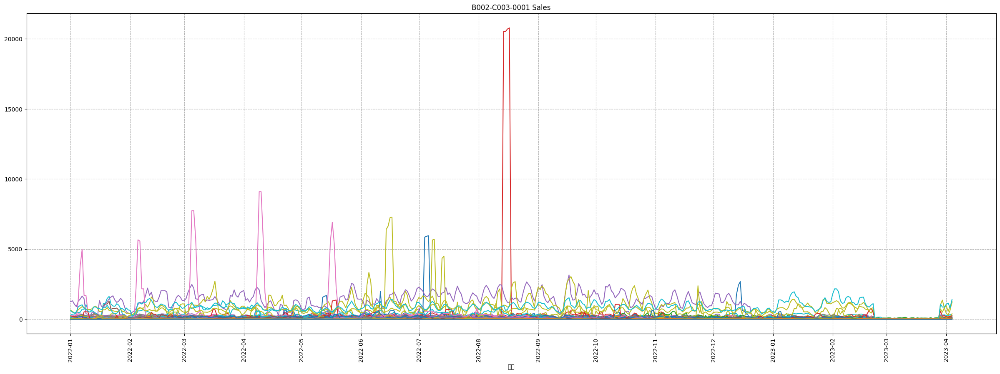

In [ ]:
data_summation = train_df.groupby(['소분류','ID','일자']).mean().reset_index()
data_summation = data_summation[data_summation['소분류']==sub_division]


plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = data_summation[data_summation['ID']==item]
    sns.lineplot(x=data['일자'], y=data['판매금액'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Price')

plt.show()

plt.figure(figsize=(30, 10))
for i,item in enumerate(sorted(original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['ID'].unique())):
    data = data_summation[data_summation['ID']==item]
    sns.lineplot(x=data['일자'], y=data['판매량'].values)
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    plt.gca().xaxis.set_major_locator(dates.MonthLocator())

    plt.title(f'{sub_division} Sales')

plt.show()

In [ ]:
data_summation = train_df.groupby(['소분류','ID','일자']).mean().reset_index()
data_summation = data_summation[(data_summation['소분류']==sub_division)&(data_summation['판매량']>2500)]
data_summation.head(50)


In [ ]:
test = train_df.copy()
for item in data_summation['ID'].unique():
    test = test.drop(test[test['ID']==item].index)

test_summation = test.groupby(['소분류','일자']).mean().reset_index()
data = test_summation[test_summation['소분류']==sub_division]

plt.figure(figsize=(30, 10))
sns.lineplot(x=data['일자'], y=data['판매량'].values,label='daily')
plt.grid(True,linestyle='--')
plt.xticks(rotation=90)
plt.gca().xaxis.set_major_locator(dates.MonthLocator())


plt.title(f'{sub_division} Sales')
plt.show()

In [ ]:
means = train_df[train_df['소분류']==sub_division].groupby(['ID','일자']).mean().reset_index()
rows = len(data_summation['ID'].unique())
cols = ['판매량','판매금액','평균판매금액','언급량']
title = ['Sales','Price','Mean Price','Keyword']
sales_meanprice = train_df[train_df['소분류']==sub_division].groupby(['ID','평균판매금액']).mean().reset_index()
for i,item in enumerate(sorted(data_summation['ID'].unique())):
    plt.subplots_adjust(hspace=1)
    plt.figure(figsize=(25, 4))
    data = means[means['ID']==item]

    for j,col in enumerate(cols):

        plt.subplot(1,5,j+1)
        plt.title(f'{item} {title[j]}')
        sns.lineplot(x=data['일자'], y=data[col].values)
        plt.grid(True,linestyle='--')
        plt.xticks(rotation=90)
        plt.gca().xaxis.set_major_locator(dates.MonthLocator())
        #plt.hlines(mean_price,data['일자'].min(),data['일자'].max(),color='green', linestyle='solid', linewidth=3)

    data = sales_meanprice[((sales_meanprice['ID']==item) & (sales_meanprice['평균판매금액']>0))]


    plt.subplot(1,5,5)
    plt.title(f'{item} Sales for price')
    sns.lineplot(x=data['평균판매금액'], y=data['판매량'].values,marker='o')
    plt.grid(True,linestyle='--')
    plt.xticks(rotation=90)
    if len(data) >0:
        plt.xlim(data['평균판매금액'].min()-1000,data['평균판매금액'].max()+1000)

    plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
product_num = 277
original_df_with_product_info[original_df_with_product_info['ID']==product_num].head()

,ID,제품,대분류,중분류,소분류,브랜드,제품특성,제품특성번호
277,277,B002-00085-00001,B002-C001-0001,B002-C002-0001,B002-C003-0001,B002-00085,제품타입:정 섭취방법:물과 함께 섭취대상:성인남녀 섭취횟수:하루 한 번 1일 총 섭...,3229


In [ ]:
original_df_with_product_info[original_df_with_product_info['ID']==product_num]['제품특성'].values

In [ ]:
original_df_with_product_info[original_df_with_product_info['소분류']==sub_division]['제품특성'].unique()

In [ ]:
original_df_with_product_info[original_df_with_product_info['제품특성']=='형태:액상형 구성:본품 등급:1종 용도:식기 용도:과일 용도:야채 용도:조리기구 용량:4000ml :1개 4L']

In [ ]:
data_summation = train_df.groupby(['ID','소분류','브랜드','일자']).sum().reset_index()

In [ ]:

mean_price = data_summation[(data_summation['소분류']==sub_division) * ( data_summation['브랜드']==original_df[original_df['ID']==product_num]['브랜드'].values[0] )]
print(mean_price['ID'].unique())
print("소분류 내에 해당 제품과 동일한 브랜드 개수 : ",mean_price['ID'].nunique())
mean_price = mean_price[mean_price['판매금액']>0]
mean_price = (mean_price['평균판매금액'].values)
print("소분류 내에 해당 제품과 동일한 브랜드의 평균 판매 가격" ,mean_price.mean())

KeyError: ignored